In [ ]:
# Set up

import pandas as pd
import numpy as np
from scipy import interpolate
import copy
import os
import matplotlib.pyplot as plt
from matplotlib.colors import hex2color, rgb2hex
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import datetime

print(os.getcwd())
os.chdir("..")
script_path = os.getcwd()
data_path = os.path.join(script_path, "data")

# Years MOT data is available for
MOT_data_years = list(range(2023, 2014, -1)) 

def process_MOT_data(df, fuel):
    print(f"Processing {fuel} data")
    print(f"Starting sample size: {df['vehicle_id'].nunique()} vehicles")
    
    print("Processing MOT data")
    
    # Convert to km
    df['test_mileage'] =  df['test_mileage']*1.61 # km
    df['mileage_per_year'] =  df['mileage_per_year']*1.61 # km


    # Reduce the memory used by the dataset
    print(f"Reducing memory usage - {df.memory_usage().sum() / 1e6:.2f} MB")
    
    # Convert object types to category if there are many repeated values
    for col in df.select_dtypes(include=['object']).columns:
        df[col] = df[col].astype('category')
    # Convert integer columns to the smallest possible integer type
    for col in df.select_dtypes(include=['int']).columns:
        df[col] = pd.to_numeric(df[col], downcast='integer')
    # Convert float columns to the smallest possible float type
    for col in df.select_dtypes(include=['float']).columns:
        df[col] = pd.to_numeric(df[col], downcast='float')
    print(f"Reduced memory usage - {df.memory_usage().sum() / 1e6:.2f} MB")
    
    print(f"Finished sample size: {df['vehicle_id'].nunique()} vehicles")
    return df

def interpolate_data(x_values, y_values, query_point, interpolate_for='x'):
    
    # Convert inputs to numpy arrays if they aren't already
    x = np.array(x_values)
    y = np.array(y_values)
    
    if interpolate_for.lower() == 'x':
        # Create interpolation function for finding y at given x
        f = interpolate.interp1d(x, y, kind='linear', 
                                fill_value='extrapolate')
        return float(f(query_point))
    
    elif interpolate_for.lower() == 'y':
        # Create interpolation function for finding x at given y
        f = interpolate.interp1d(y, x, kind='linear', 
                                fill_value='extrapolate')
        return float(f(query_point))
    
    else:
        raise ValueError("interpolate_for must be either 'x' or 'y'")

def get_fuel_labels(fuel):
    fuel_labels = {
        'car_diesel' : 'Diesel', 
        'car_petrol' : 'Petrol', 
        'car_hev' : 'HEV', 
        'car_bev' : 'BEV',
        'lgv': 'LGV',
        'mcycle' : 'Motorcycle',
        'car_bev_battery_30' : "< 30 kWh",
        'car_bev_battery_60' : "30-60 kWh",
        'car_bev_battery_100' : "> 60 kWh",
        }
    return  fuel_labels[fuel]

def get_fuel_labels_disag(fuel):
    fuel_labels = {
        'car_diesel' : 'Diesel', 
        'car_petrol' : 'Petrol', 
        'car_hev' : 'HEV', 
        'car_bev' : 'All BEVs',
        'lgv': 'LGV',
        'mcycle' : 'Motorcycle',
        'car_bev_battery_30' : "< 30 kWh",
        'car_bev_battery_60' : "30-60 kWh",
        'car_bev_battery_100' : "> 60 kWh",
        }
    return  fuel_labels[fuel]

def get_fuel_cut_off_year(fuel):
    fuel_cut_off_year = {
        'car_diesel' : 1994, 
        'car_petrol' : 1994, 
        'car_hev' : 2007, 
        'car_bev' : 2012,
        'lgv': 1994,
        'mcycle' : 1994
        }
    return fuel_cut_off_year[fuel]

def y_fmt(y, pos):
    decades = [1e9, 1e6, 1e3, 1e0, 1e-3, 1e-6, 1e-9 ]
    suffix  = ["G", "M", "k", "" , "m" , "u", "n"  ]
    if y == 0:
        return str(0)
    for i, d in enumerate(decades):
        if np.abs(y) >=d:
            val = y/float(d)
            signf = len(str(val).split(".")[1])
            if signf == 0:
                return '{val:d} {suffix}'.format(val=int(val), suffix=suffix[i])
            else:
                if signf == 1:
                    #print val, signf
                    if str(val).split(".")[1] == "0":
                       return '{val:d} {suffix}'.format(val=int(round(val)), suffix=suffix[i]) 
                tx = "{"+"val:.{signf}f".format(signf = signf) +"} {suffix}"
                return tx.format(val=val, suffix=suffix[i])

def create_colormap(colors, n):

    # Convert hex colors to RGB
    rgb_colors = [hex2color(color) for color in colors]
    
    # Create position array for input colors
    positions = np.linspace(0, 1, len(colors))
    
    # Create position array for output colors
    output_positions = np.linspace(0, 1, n)
    
    # Initialize output RGB arrays
    r = np.interp(output_positions, positions, [color[0] for color in rgb_colors])
    g = np.interp(output_positions, positions, [color[1] for color in rgb_colors])
    b = np.interp(output_positions, positions, [color[2] for color in rgb_colors])
    
    # Convert back to hex
    output_colors = [rgb2hex((r[i], g[i], b[i])) for i in range(n)]
    
    return output_colors




d:\MOT_CO\code


In [3]:
# Read in data for figures and scrappage analysis

fuel_data = {}
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    
    # Read in Data
    fpath = os.path.join(data_path, "Sample_Data", f"sample_{fuel}_all_years.parquet")
    # Only use cols we need for the mileage & scrappage analysis
    cols = [
        "vehicle_id", "test_date", "test_mileage", "mileage_per_year", "first_use_year", "battery capacity (kWh)", "fuel efficiency Wh/mi",
        "make", "age_year_rounded", "test_year", "fuel_type", "last_test", "first_test", "ev_type", "age_year",
    ]
    df = pd.read_parquet(fpath, engine='pyarrow', columns=cols)
    
    # Use the VCA car speck to keep only hevs (exclude hevs and non-matched vehicles)
    if fuel == "car_hev":
        df = df[df["ev_type"]!="phev"]
    
    if fuel == "car_bev":
        # only keep BEVs with battery capacity
        df = df[~df["battery capacity (kWh)"].isnull()].copy()
    
    df = process_MOT_data(df, fuel)    
    fuel_data[fuel] = df
    
    if fuel == "car_bev":
        
        # Breifly summarise the battery sizes by reg year
        for year in range(2012, 2021, 1):
            battery_size = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==year), "battery capacity (kWh)"].mean()
            fuel_consumption = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==year), "fuel efficiency Wh/mi"].mean()
            print(f"Year: {year}, Battery size: {battery_size}, Fuel consumption: {fuel_consumption}")
        
        battery_id_lookup = {}
        # battery_siz_id is the batery size label, battery_sizes are the ranges
        for battery_siz_id, battery_sizes in zip([30, 60, 100], [[0, 30] , [30, 60], [60, 200]]):
            ids = []
            ids_exclude = []
            for year in range(2012, 2021, 1):
                
                ids_year = list(fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==year) &
                                                    (fuel_data[fuel]["battery capacity (kWh)"] > battery_sizes[0]) &
                                                    (fuel_data[fuel]["battery capacity (kWh)"] <= battery_sizes[1])
                                                    , "vehicle_id"].unique())
                
                # if sample size is too small, remove these evs from the sample
                # These skew the mileaages for the oldest years
                if len(ids_year) < 10:
                    ids_exclude.extend(ids_year)
                    fuel_data[fuel] = fuel_data[fuel][~fuel_data[fuel]["vehicle_id"].isin(ids_year)].copy()
                    continue
                
                ids.extend(ids_year)
                print(f"Year: {year}, Battery ID: {battery_siz_id}, Thresholds: {battery_sizes[0]} to {battery_sizes[1]}, Number of vehicles: {len(ids)}")
                
            battery_id_lookup[battery_siz_id] = ids
            
            _df = fuel_data[fuel][fuel_data[fuel]["vehicle_id"].isin(ids)].copy()
            fuel_data[fuel + f"_battery_{battery_siz_id}"] = _df
            print(f"Finished sample size: {fuel_data[fuel + f'_battery_{battery_siz_id}']['vehicle_id'].nunique()} vehicles")
            


Processing car_hev data
Starting sample size: 616263 vehicles
Processing MOT data
Reducing memory usage - 479.02 MB
Reduced memory usage - 270.08 MB
Finished sample size: 616263 vehicles
Processing car_bev data
Starting sample size: 168399 vehicles
Processing MOT data
Reducing memory usage - 97.03 MB
Reduced memory usage - 54.71 MB
Finished sample size: 168399 vehicles
Year: 2012, Battery size: 21.755220413208008, Fuel consumption: 272.0755615234375
Year: 2013, Battery size: 23.564302444458008, Fuel consumption: 274.6456298828125
Year: 2014, Battery size: 30.174192428588867, Fuel consumption: 280.7383117675781
Year: 2015, Battery size: 35.197357177734375, Fuel consumption: 278.0504455566406
Year: 2016, Battery size: 41.57383346557617, Fuel consumption: 281.92877197265625
Year: 2017, Battery size: 48.310794830322266, Fuel consumption: 292.7142028808594
Year: 2018, Battery size: 51.32965850830078, Fuel consumption: 287.9889831542969
Year: 2019, Battery size: 57.42924880981445, Fuel consu

In [3]:
# Calculate Survival Rate Data

# Before we calculate the Survival rates 
# Print out summary surival ages for each fuel type and reg year
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    median_age = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "age_year"].median()
    mean_age = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "age_year"].mean()
    std_age = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "age_year"].std()
    percentile_25_age = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "age_year"].quantile(0.25)
    percentile_75_age = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "age_year"].quantile(0.75)
    
    median_mileage = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "test_mileage"].median()
    mean_mileage = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "test_mileage"].mean()
    std_mileage = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "test_mileage"].std()
    percentile_25_mileage = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "test_mileage"].quantile(0.25)
    percentile_75_mileage = fuel_data[fuel].loc[fuel_data[fuel]["last_test"]==True, "test_mileage"].quantile(0.75)
    
    print(f"Fuel: {fuel}, Median Age: {median_age:.2f}, Mean Age: {mean_age:.2f}, Std Age: {std_age:.2f}, 25th Percentile Age: {percentile_25_age:.2f}, 75th Percentile Age: {percentile_75_age:.2f}")
    print(f"Fuel: {fuel}, Median Mileage: {median_mileage:.2f}, Mean Mileage: {mean_mileage:.2f}, Std Mileage: {std_mileage:.2f}, 25th Percentile Mileage: {percentile_25_mileage:.2f}, 75th Percentile Mileage: {percentile_75_mileage:.2f}")
    print("\n")
    
    for reg_year in range(2005, 2021, 1):
        
        median_age = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "age_year"].median()
        mean_age = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "age_year"].mean()
        std_age = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "age_year"].std()
        percentile_25_age = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "age_year"].quantile(0.25)
        percentile_75_age = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "age_year"].quantile(0.75)
        
        median_mileage = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "test_mileage"].median()
        mean_mileage = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "test_mileage"].mean()
        std_mileage = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "test_mileage"].std()
        percentile_25_mileage = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "test_mileage"].quantile(0.25)
        percentile_75_mileage = fuel_data[fuel].loc[(fuel_data[fuel]["first_use_year"]==reg_year) & (fuel_data[fuel]["last_test"]==True), "test_mileage"].quantile(0.75)
        
        print(f"Fuel: {fuel}, Reg Year: {reg_year}, Median Age: {median_age:.2f}, Mean Age: {mean_age:.2f}, Std Age: {std_age:.2f}, 25th Percentile Age: {percentile_25_age:.2f}, 75th Percentile Age: {percentile_75_age:.2f}")
        print(f"Fuel: {fuel}, Reg Year: {reg_year}, Median Mileage: {median_mileage:.2f}, Mean Mileage: {mean_mileage:.2f}, Std Mileage: {std_mileage:.2f}, 25th Percentile Mileage: {percentile_25_mileage:.2f}, 75th Percentile Mileage: {percentile_75_mileage:.2f}")
        print("\n")
    

# First get DfT Survival rates using VEH1111 data
# Convert VEH1111 data to percentages
print("Converting VEH1111 data to percentages")
folder = "survival_rate_data"
fname = f"VEH1111_Summary_Data.csv"
fpath = os.path.join(data_path, folder, fname)
df = pd.read_csv(fpath)

fuels = [ "car_hev", "car_bev", "car_diesel", "car_petrol" ]
for fuel in fuels:
    for reg_year in range(1994, 2024, 1):
        
        if reg_year < get_fuel_cut_off_year(fuel):
            continue    
        
        stock = df.loc[
            (df["year"] >= reg_year) & # year is date
            (df["fuel"] == fuel),
            str(reg_year)
            ].to_list()
        
        percentage = [i / max(stock) for i in stock]
        
        df.loc[
            (df["year"] >= reg_year) & # year is date
            (df["fuel"] == fuel),
            str(reg_year)] = percentage
            
        
dft_survival_data = df
folder = "survival_rate_data"
fname = f"VEH1111_Summary_Data_Percentages.csv"
fpath = os.path.join(data_path, folder, fname)
dft_survival_data.to_csv(fpath)

print("Converting MOT data to VEH1111 format")

fuel_lookup = {
    "car_diesel": "DI",
    "car_petrol": "PE",
    "car_bev": "EL",
    "car_hev": "HY"
}

rows = []
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    df = fuel_data[fuel]
    for year in range(2005, 2024, 1):
        reg_year_data = []
        for reg_year in range(2020, 1993, -1): # backwards to match dft format
            
            # get number of vehicles in reg_year in year
            n = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[fuel]), "vehicle_id"].nunique()   
            reg_year_data.append(n)
            
            # print(fuel, year, reg_year, n)
        rows.append([fuel, year] + reg_year_data)
            

df_out = pd.DataFrame(rows, columns=["fuel", "year"] + list(range(2020, 1993, -1)))

# Add a correction - set all ages below 3 to the same stock as 3
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    # print(f"Correcting ages below 3 for {fuel}")
    for year in range(2005, 2024, 1):
        for reg_year in range(1994, 2021, 1):  # backwards to match dft format
            age = year - reg_year
            year_age_3 = reg_year + 2
            if age < 0:
               df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = 0 
            elif age < 3:
                df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year_age_3), reg_year].values[0]
                        
folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format.csv"
fpath = os.path.join(data_path, folder, fname)                 
df_out.to_csv(fpath)

# Convert the data to percentages

print("Converting MOT data to VEH1111 format - percentages")

# First change the column types to float
for col in df_out.columns:
    if col in ["fuel", "year"]:
        continue
    df_out[col] = df_out[col].astype(float)

fuels = [ "car_hev", "car_bev", "car_diesel", "car_petrol" ]
for fuel in fuels:
    for reg_year in range(1994, 2021, 1):
        
        stock = df_out.loc[
            (df_out["year"] >= reg_year) & # year is date
            (df_out["fuel"] == fuel),
            reg_year
            ].to_list()
        
        max_stock = max(stock) 
        try: 
            percentage = [i / max(stock) for i in stock]
        except:
            percentage = [0 for i in stock]
        
        df_out.loc[
            (df_out["year"] >= reg_year) & # year is date
            (df_out["fuel"] == fuel),
            reg_year] = percentage

folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_percentages.csv"
fpath = os.path.join(data_path, folder, fname)
df_out.to_csv(fpath)  

         
# Finaly combine thg MOT and DfT Data
# Use the first 3 years of the dft data  
# Then use the MOT data - need to multiply the %'s from dft onwards to propagate the coprrect survival rate  

print("Combining MOT and DfT data")

# Read in the MOT data
folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_percentages.csv"
fpath = os.path.join(data_path, folder, fname)
df_mot = pd.read_csv(fpath)
folder = "survival_rate_data"
fname = f"VEH1111_Summary_Data_Percentages.csv"
fpath = os.path.join(data_path, folder, fname)
df_dft = pd.read_csv(fpath)

df_combined = df_dft.copy()

# Combine the data
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    for reg_year in range(1994, 2021, 1):
        
        dft_cut_off_year = reg_year + 2
        if dft_cut_off_year < 2004:
            dft_cut_off_year = 2004
        
        # get the first three ages from the dft data
        years_age = list(range(reg_year, dft_cut_off_year + 1, 1))
        dft_data = df_dft.loc[
            (df_dft["fuel"] == fuel) & 
            (df_dft["year"].isin(years_age)
            ), 
            str(reg_year) # dft cols are strings
        ].to_list()
        
        start_year = dft_cut_off_year + 1
        years_age = list(range(start_year, 2024, 1))
        mot_data = df_mot.loc[
            (df_mot["fuel"] == fuel) & 
            (df_mot["year"].isin(years_age)
            ), 
            str(reg_year)
        ].to_list()
        
        # print(fuel, reg_year, dft_data, mot_data)
        
        # combine the data
        combined_data = copy.copy(dft_data)
        year_3_sr = dft_data[-1]
        for scrap_rate in mot_data:
            combined_data.append(year_3_sr * scrap_rate)
        
        # add data to the combined dataframe
        df_combined.loc[
            (df_combined["fuel"] == fuel) & 
            (df_combined["year"].isin(range(reg_year, 2024, 1))
            ), 
            str(reg_year)
        ] = combined_data

folder = "survival_rate_data"
fname = f"MOT_and_DfT_combined_data.csv"
fpath = os.path.join(data_path, folder, fname)
df_combined.to_csv(fpath)

# Calculate Survival Rates
print("Converting MOT data to VEH1111 format and recording mileage of vehicles")

fuel_lookup = {
    "car_diesel": "DI",
    "car_petrol": "PE",
    "car_bev": "EL",
    "car_hev": "HY"
}

rows = []
rows_stderr = []
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    df = fuel_data[fuel]
    for year in range(2005, 2024, 1):
    
        reg_year_data = []
        reg_year_data_stderr = []
        for reg_year in range(2020, 1993, -1): # backwards to match dft format
            
            mileage = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[fuel]) & (df["last_test"]==True), "test_mileage"].mean()
            reg_year_data.append(mileage)
            
            try:
                std = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[fuel]) & (df["last_test"]==True), "test_mileage"].std()
                n = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[fuel]) & (df["last_test"]==True), "test_mileage"].count()
                stderr = std / np.sqrt(n)
                reg_year_data_stderr.append(stderr)
            except:
                reg_year_data_stderr.append(0)
            
        rows.append([fuel, year] + reg_year_data)
        rows_stderr.append([fuel, year] + reg_year_data_stderr)

df_out = pd.DataFrame(rows, columns=["fuel", "year"] + list(range(2020, 1993, -1)))           
df_out_stderr = pd.DataFrame(rows_stderr, columns=["fuel", "year"] + list(range(2020, 1993, -1)))          

# Add a correction - set all ages below 3 to the same stock as 3
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    # print(f"Correcting ages below 3 for {fuel}")
    for year in range(2005, 2024, 1):
        for reg_year in range(1994, 2021, 1):  # backwards to match dft format
            
            age = year - reg_year
            year_age_4 = reg_year + 3
            if age < 0:
               df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = 0 
               df_out_stderr.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = 0
            elif age <= 3:
                df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year_age_4), reg_year].values[0]
                df_out_stderr.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = df_out_stderr.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year_age_4), reg_year].values[0]
                
folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_mileage.csv"
fpath = os.path.join(data_path, folder, fname)
df_out.to_csv(fpath)
folder= "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_mileage_stderr.csv"
fpath = os.path.join(data_path, folder, fname)
df_out_stderr.to_csv(fpath)                
    
# Calculate Survival Rate Data - with additional BEV disaggregation
fuels = ["car_hev", "car_bev", "car_diesel", "car_petrol"]
bev_disaggregation = ["car_bev_battery_30", "car_bev_battery_60", "car_bev_battery_100"]
# Note make dissagregation not used in paper

# First get DfT Survival rates using VEH1111 data
# Convert VEH1111 data to percentages
print("Converting VEH1111 data to percentages")
folder = "survival_rate_data"
fname = f"VEH1111_Summary_Data.csv"
fpath = os.path.join(data_path, folder, fname)
df = pd.read_csv(fpath)

fuels = [ "car_hev", "car_bev", "car_diesel", "car_petrol"]
for fuel in fuels + bev_disaggregation:
        
    # Use different fuel cut off years for BEV disaggregation
    _fuel = fuel

    # First copy the data for bev disaggregation then continue as normal
    if fuel in bev_disaggregation:
        _df = df.loc[df["fuel"]=="car_bev"].copy()
        _df["fuel"] = fuel
        df = pd.concat([df, _df])
        _fuel = "car_bev"
    
    for reg_year in range(1994, 2024, 1):

        if reg_year < get_fuel_cut_off_year(_fuel):
            # print(fuel, reg_year, "Skipped")
            continue    
        
        stock = df.loc[
            (df["year"] >= reg_year) & # year is date
            (df["fuel"] == fuel),
            str(reg_year)
            ].to_list()
        
        percentage = [i / max(stock) for i in stock]
        
        df.loc[
            (df["year"] >= reg_year) & # year is date
            (df["fuel"] == fuel),
            str(reg_year)] = percentage
            
        
dft_survival_data = df

folder = "survival_rate_data"
fname = f"VEH1111_Summary_Data_Percentages_bev_disag.csv"
fpath = os.path.join(data_path, folder, fname)
dft_survival_data.to_csv(fpath)


print("Converting MOT data to VEH1111 format")

fuel_lookup = {
    "car_diesel": "DI",
    "car_petrol": "PE",
    "car_bev": "EL",
    "car_hev": "HY"
}

rows = []
for fuel in fuels + bev_disaggregation:
    df = fuel_data[fuel]
    for year in range(2005, 2024, 1):
        reg_year_data = []
        for reg_year in range(2020, 1993, -1): # backwards to match dft format
            
            # Use _fuel for fuel_lookup
            _fuel = fuel
            if fuel in bev_disaggregation:
                _fuel = "car_bev"
            
            # get number of vehicles in reg_year in years
            n = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[_fuel]), "vehicle_id"].nunique()   
            reg_year_data.append(n)
            
            # print(fuel, year, reg_year, n)
        rows.append([fuel, year] + reg_year_data)

df_out = pd.DataFrame(rows, columns=["fuel", "year"] + list(range(2020, 1993, -1)))

# Add a correction - set all ages below 3 to the same stock as 3
for fuel in fuels + bev_disaggregation:
    # print(f"Correcting ages below 3 for {fuel}")
    for year in range(2005, 2024, 1):
        for reg_year in range(1994, 2021, 1):  # backwards to match dft format     
            
            # DO NOT use _fuel here as we are using the data in df_out 
            
            age = year - reg_year
            year_age_3 = reg_year + 2
            if age < 0:
               df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = 0 
            elif age < 3:
                df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year_age_3), reg_year].values[0]
                
folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_bev_disag.csv"    
fpath = os.path.join(data_path, folder, fname) 
df_out.to_csv(fpath)

# Convert the data to percentages
print("Converting MOT data to VEH1111 format - percentages")

# First chnage the column types to float
for col in df_out.columns:
    if col in ["fuel", "year"]:
        continue
    df_out[col] = df_out[col].astype(float)

for fuel in fuels + bev_disaggregation:
    for reg_year in range(1994, 2021, 1):
        
        stock = df_out.loc[
            (df_out["year"] >= reg_year) & # year is date
            (df_out["fuel"] == fuel),
            reg_year
            ].to_list()
        
        max_stock = max(stock) 
        try: 
            percentage = [i / max(stock) for i in stock]
        except:
            percentage = [0 for i in stock]
        
        df_out.loc[
            (df_out["year"] >= reg_year) & # year is date
            (df_out["fuel"] == fuel),
            reg_year] = percentage

folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_percentages_bev_disag.csv"
fpath = os.path.join(data_path, folder, fname)        
df_out.to_csv(fpath)  

         
# Finalyl combine thg MOT anbd DfT Data
# Use the first 3 years of the dft data  
# Then use the MOT data - need to multiply the %'s from dft onwards to porpgate the Survival rate  

print("Combining MOT and DfT data")

# Read in the MOT data
folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_percentages_bev_disag.csv"
fpath = os.path.join(data_path, folder, fname)
df_mot = pd.read_csv(fpath)
folder = "survival_rate_data"
fname = f"VEH1111_Summary_Data_Percentages_bev_disag.csv"
fpath = os.path.join(data_path, folder, fname)
df_dft = pd.read_csv(fpath)

df_combined = df_dft.copy()

# Combine the data
for fuel in fuels + bev_disaggregation:
    for reg_year in range(1994, 2021, 1):
        
        dft_cut_off_year = reg_year + 2
        if dft_cut_off_year < 2004:
            dft_cut_off_year = 2004
        
        # get the first three ages from the dft data
        years_age = list(range(reg_year, dft_cut_off_year + 1, 1))
        dft_data = df_dft.loc[
            (df_dft["fuel"] == fuel) & 
            (df_dft["year"].isin(years_age)
            ), 
            str(reg_year) # dft cols are strings
        ].to_list()
        
        start_year = dft_cut_off_year + 1
        years_age = list(range(start_year, 2024, 1))
        mot_data = df_mot.loc[
            (df_mot["fuel"] == fuel) & 
            (df_mot["year"].isin(years_age)
            ), 
            str(reg_year)
        ].to_list()
        
        # print(fuel, reg_year, dft_data, mot_data)
        
        # combine the data
        combined_data = copy.copy(dft_data)
        year_3_sr = dft_data[-1]
        for scrap_rate in mot_data:
            combined_data.append(year_3_sr * scrap_rate)
        
        # add data to the combined dataframe
        df_combined.loc[
            (df_combined["fuel"] == fuel) & 
            (df_combined["year"].isin(range(reg_year, 2024, 1))
            ), 
            str(reg_year)
        ] = combined_data

folder = "survival_rate_data"
fname = f"MOT_and_DfT_combined_data_bev_disag.csv"
fpath = os.path.join(data_path, folder, fname)
df_combined.to_csv(fpath)

# Calculate Survival Rates
print("Converting MOT data to VEH1111 format and recording mileage of vehicles")

fuel_lookup = {
    "car_diesel": "DI",
    "car_petrol": "PE",
    "car_bev": "EL",
    "car_hev": "HY"
}

rows = []
rows_stderr = []
for fuel in fuels + bev_disaggregation:
    df = fuel_data[fuel]
    for year in range(2005, 2024, 1):
        
        _fuel = fuel
        if fuel in bev_disaggregation:
            _fuel = "car_bev"
        
        reg_year_data = []
        reg_year_data_stderr = []
        for reg_year in range(2020, 1993, -1): # backwards to match dft format
            
            mileage = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[_fuel]) & (df["last_test"]==True), "test_mileage"].mean()
            reg_year_data.append(mileage)
            
            try:
                std = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[_fuel]) & (df["last_test"]==True), "test_mileage"].std()
                n = df.loc[(df["first_use_year"]==reg_year) & (df["test_year"]==year) & (df["fuel_type"]==fuel_lookup[_fuel]) & (df["last_test"]==True), "test_mileage"].count()
                stderr = std / np.sqrt(n)
                reg_year_data_stderr.append(stderr)
            except:
                reg_year_data_stderr.append(0)
            
            # print(fuel, year, reg_year, mileage)
        rows.append([fuel, year] + reg_year_data)
        rows_stderr.append([fuel, year] + reg_year_data_stderr)

df_out = pd.DataFrame(rows, columns=["fuel", "year"] + list(range(2020, 1993, -1))) 
df_out_stderr = pd.DataFrame(rows_stderr, columns=["fuel", "year"] + list(range(2020, 1993, -1)))          

# Add a correction - set all ages below 3 to the same stock as 3
for fuel in fuels + bev_disaggregation:
    # print(f"Correcting ages below 3 for {fuel}")
    for year in range(2005, 2024, 1):
        for reg_year in range(1994, 2021, 1):  # backwards to match dft format
            
            age = year - reg_year
            year_age_4 = reg_year + 3
            if age < 0:
                df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = 0 
                df_out_stderr.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = 0
            elif age <= 3:
                df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = df_out.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year_age_4), reg_year].values[0]
                df_out_stderr.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year), reg_year] = df_out_stderr.loc[(df_out["fuel"]==fuel) & (df_out["year"]==year_age_4), reg_year].values[0]
                
folder = "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_mileage_bev_disag.csv"
fpath = os.path.join(data_path, folder, fname)
df_out.to_csv(fpath)
folder= "survival_rate_data"
fname = f"MOT_data_to_VEH1111_format_mileage_stderr_bev_disag.csv"
fpath = os.path.join(data_path, folder, fname)
df_out_stderr.to_csv(fpath)


Fuel: car_hev, Median Age: 4.80, Mean Age: 5.67, Std Age: 3.09, 25th Percentile Age: 3.00, 75th Percentile Age: 7.08
Fuel: car_hev, Median Mileage: 62142.78, Mean Mileage: 87897.47, Std Mileage: 80421.37, 25th Percentile Mileage: 36984.92, 75th Percentile Mileage: 108402.91


Fuel: car_hev, Reg Year: 2005, Median Age: 17.65, Mean Age: 16.00, Std Age: 3.47, 25th Percentile Age: 15.01, 75th Percentile Age: 18.04
Fuel: car_hev, Reg Year: 2005, Median Mileage: 229933.76, Mean Mileage: 233464.60, Std Mileage: 87707.98, 25th Percentile Mileage: 171769.29, 75th Percentile Mileage: 289474.78


Fuel: car_hev, Reg Year: 2006, Median Age: 16.72, Mean Age: 15.24, Std Age: 3.29, 25th Percentile Age: 14.96, 75th Percentile Age: 17.05
Fuel: car_hev, Reg Year: 2006, Median Mileage: 221415.25, Mean Mileage: 232958.65, Std Mileage: 93750.23, 25th Percentile Mileage: 169677.90, 75th Percentile Mileage: 284311.51


Fuel: car_hev, Reg Year: 2007, Median Age: 15.86, Mean Age: 14.28, Std Age: 3.56, 25th Perc

Plot a
Plot b
Plot c


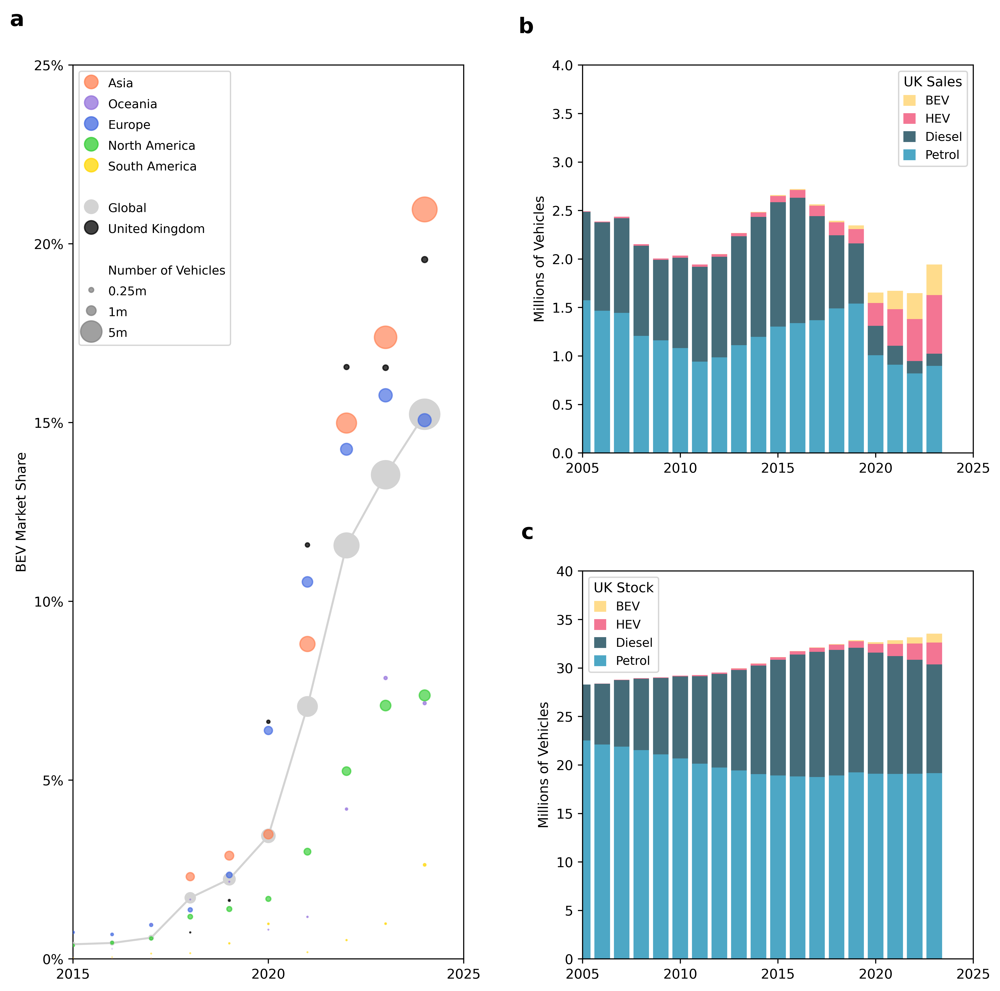

In [2]:
# Figure 1 - Sales and Stock

# Set up figure and axes - 1 rows of 4 figures
fig = plt.figure(figsize=(12,12), dpi=500)
gs = fig.add_gridspec(9, 9)
ax_a = fig.add_subplot(gs[0:9, 0:4])
ax_b = fig.add_subplot(gs[0:4, 5:9])
ax_c = fig.add_subplot(gs[5:9, 5:9])
# ax_d = fig.add_subplot(gs[0:9, 14:18])

fpath = os.path.join(data_path, "ev_data", "andrew_2025_all_carsales_monthly.csv")
df_bev_sales = pd.read_csv(fpath)
fpath = os.path.join(data_path, "ev_data", "GB_sales_2005_2023.csv")
df_sales= pd.read_csv(fpath)
fpath = os.path.join(data_path, "ev_data", "GB_stock_2005_2023.csv")
df_stock = pd.read_csv(fpath)

print("Plot a")

# drop United Kingdom SMMT
df_bev_sales = df_bev_sales.loc[df_bev_sales["Country"]!="United Kingdom"]
# rename United Kingdom SMMT to United Kingdom
df_bev_sales["Country"] = df_bev_sales["Country"].apply(lambda x: "United Kingdom" if x=="United Kingdom SMMT" else x)

# Editr the data first -strftime the date YYYYMM
df_bev_sales["Date"] = pd.to_datetime(df_bev_sales["YYYYMM"], format="%Y%m")
df_bev_sales["Year"] = df_bev_sales["Date"].dt.year

# convert to million units
df_bev_sales["Value"] = df_bev_sales["Value"] / 1000000 

# group by year and sum the sales
df_bev_sales = df_bev_sales.groupby(["Year", "Country", "Fuel"]).sum(numeric_only=True).reset_index()

continent_colors = {
    "Europe": "#4169E1",    # Blue
    "Asia": "#FF7F50",      # Orange
    "North America": "#32CD32",  # Green
    "South America": "#FFD700",  # Yellow
    "Oceania": "#9370DB"    # Purple
}

country_continents = {
    "Australia": "Oceania",
    "Austria": "Europe",
    "Brazil": "South America",
    "Canada": "North America",
    "China": "Asia",
    "Colombia": "South America",
    "Czechia": "Europe",
    "Denmark": "Europe",
    "Finland": "Europe",
    "France": "Europe",
    "Germany": "Europe",
    "Iceland": "Europe",
    "India": "Asia",
    "Indonesia": "Asia",
    "Ireland": "Europe",
    "Israel": "Asia",
    "Italy": "Europe",
    "Japan": "Asia",
    "Luxembourg": "Europe",
    "Malaysia": "Asia",
    "Mexico": "North America",
    "Netherlands": "Europe",
    "New Zealand": "Oceania",
    "Norway": "Europe",
    "Poland": "Europe",
    "Portugal": "Europe",
    "Singapore": "Asia",
    "Spain": "Europe",
    "Sweden": "Europe",
    "Switzerland": "Europe",
    "Thailand": "Asia",
    "Turkey": "Asia",
    "USA": "North America",
    "United Kingdom": "Europe",
    "Uruguay": "South America"
}

# aggregate the data based upon the continets
df_bev_sales["Continent"] = df_bev_sales["Country"].apply(lambda x: country_continents[x])
df_bev_sales_cont = df_bev_sales.groupby(["Year", "Fuel", "Continent"]).sum(numeric_only=True).reset_index()
df_bev_sales_uk = df_bev_sales.loc[df_bev_sales["Country"]=="United Kingdom"].copy()
df_bev_sales_global = df_bev_sales.groupby(["Year", "Fuel"]).sum(numeric_only=True).reset_index()

# Now create percentages of the total sales for each year 
# groupby the year and country, then divide by the sum of the sales for that year
df_bev_sales_cont["Percentage"] = df_bev_sales_cont.groupby(["Year", "Continent"])["Value"].transform(lambda x: x / x.sum())
df_bev_sales_uk["Percentage"] = df_bev_sales_uk.groupby(["Year"])["Value"].transform(lambda x: x / x.sum())
df_bev_sales_global["Percentage"] = df_bev_sales_global.groupby(["Year"])["Value"].transform(lambda x: x / x.sum())

# Keep only years between 2005 and 2023
df_bev_sales_cont = df_bev_sales_cont.loc[(df_bev_sales_cont["Year"] >= 2005) & (df_bev_sales_cont["Year"] <= 2024)]
df_bev_sales_uk = df_bev_sales_uk.loc[(df_bev_sales_uk["Year"] >= 2005) & (df_bev_sales_uk["Year"] <= 2024)]
df_bev_sales_global = df_bev_sales_global.loc[(df_bev_sales_global["Year"] >= 2005) & (df_bev_sales_global["Year"] <= 2024)]

# Only keep BEVs
df_bev_sales_cont = df_bev_sales_cont.loc[df_bev_sales_cont["Fuel"]=="BatteryElectric"]
df_bev_sales_uk = df_bev_sales_uk.loc[df_bev_sales_uk["Fuel"]=="BatteryElectric"]
df_bev_sales_global = df_bev_sales_global.loc[df_bev_sales_global["Fuel"]=="BatteryElectric"]

for continent in continent_colors.keys():
    df_continent = df_bev_sales_cont.loc[df_bev_sales_cont["Continent"]==continent]
    ax_a.scatter(df_continent["Year"], df_continent["Percentage"], s=df_continent["Value"]*50, alpha=0.66, color=continent_colors[continent], zorder=4)

# plot UK separately
ax_a.scatter(df_bev_sales_uk["Year"], df_bev_sales_uk["Percentage"],s=df_bev_sales_uk["Value"]*50, color="black", alpha=0.75, zorder=6)

# plot global
ax_a.scatter(df_bev_sales_global["Year"], df_bev_sales_global["Percentage"], s=df_bev_sales_global["Value"]*50, color="lightgrey", zorder=3, alpha=1)
ax_a.plot(df_bev_sales_global["Year"], df_bev_sales_global["Percentage"], color="lightgrey", alpha=1, zorder=1)

# Now create a fake legend to match the colors and scatter size 
# Contient colours
continent_colors = {
    "Asia": "#FF7F50",      # Orange
    "Oceania": "#9370DB",    # Purple
    "Europe": "#4169E1",    # Blue
    "North America": "#32CD32",  # Green
    "South America": "#FFD700",  # Yellow
}
# ax_a.scatter([], [], color="white", label="Continent", s=100, alpha=0.75)
for continent in continent_colors.keys():
    ax_a.scatter([], [], color=continent_colors[continent], label=continent, s=100, alpha=0.75)
ax_a.scatter([], [], color="white", label=" ", s=100, alpha=0.75)
# Add global sales and UK
ax_a.scatter([], [], color='lightgrey', label="Global", s=100, alpha=1)
ax_a.scatter([], [], color='black', label="United Kingdom", s=100, alpha=0.75)
ax_a.scatter([], [], color="white", label=" ", s=100, alpha=0.75)
# Add vehicle sales sizes for scatter s
ax_a.scatter([], [], color="white", label="Number of Vehicles", s=100, alpha=0.75)
sizes = [0.25, 1, 5]
for size in sizes:
    ax_a.scatter([], [], color="grey", label=f"{size}m", s=size*50, alpha=0.75)
    

# set ylim to percentage 
ax_a.set_ylim(0, 0.25)
ax_a.set_yticks(np.arange(0, 0.26, 0.05))
ax_a.set_yticklabels(["0%", "5%", "10%", "15%", "20%", "25%"])
ax_a.legend(handleheight=1.5, handlelength=1.2, fontsize=9, loc='upper left')
ax_a.set_xlim(2015, 2025)
ax_a.set_xticks(range(2015, 2026, 5))
ax_a.set_ylabel("BEV Market Share")


print("Plot b")
colors = ["#ffd166", "#ef476f", "#118ab2", "#073b4c"] 
fuels = ["BEV", "HEV", "Diesel", "Petrol"]

stack_order = ['Petrol', 'Diesel', 'HEV', 'BEV', ]

# Create dictionary mapping fuel types to their data

# Stacked bar shart of sales 2005 to 2023 in df_sales
years = df_sales["year"]
bev_sales = df_sales["BEV"]/1000
hev_sales = df_sales["HEV"]/1000
petrol_sales = df_sales["Petrol"]/1000
diesel_sales = df_sales["Diesel"]/1000

data = {
    'BEV': bev_sales,
    'HEV': hev_sales,
    'Petrol': petrol_sales,
    'Diesel': diesel_sales,
}

# Create dictionary mapping fuel types to their colors
color_map = dict(zip(['BEV', 'HEV', 'Petrol', 'Diesel'], colors))

# Plot stacked bars
bottom = [0] * len(years) 
for fuel in stack_order:
    ax_b.bar(years, data[fuel], 
             color=color_map[fuel], 
             label=fuel, 
             bottom=bottom, 
             alpha=0.75)
    bottom += data[fuel]
  
ax_b.set_ylim(0, 4)

# reverse handle order of legend
handles, labels = ax_b.get_legend_handles_labels()
ax_b.legend( reversed(handles), reversed(labels), title="UK Sales", handleheight=1, handlelength=1, fontsize=9)
ax_b.set_ylabel("Millions of Vehicles")

print("Plot c")
colors = ["#ffd166", "#ef476f", "#118ab2", "#073b4c"] 
fuels = ["BEV", "HEV", "Diesel", "Petrol"]
# Stacked bar shart of sales 2005 to 2023 in df_sales
years = df_stock["year"]
bev_stock= df_stock["BEV"]/1000
hev_stock= df_stock["HEV"]/1000
petrol_stock= df_stock["Petrol"]/1000
diesel_stock= df_stock["Diesel"]/1000

data = {
    'BEV': bev_stock,
    'HEV': hev_stock,
    'Petrol': petrol_stock,
    'Diesel': diesel_stock,
}

# Create dictionary mapping fuel types to their colors
color_map = dict(zip(['BEV', 'HEV', 'Petrol', 'Diesel'], colors))

# Plot stacked bars
bottom = [0] * len(years) 
for fuel in stack_order:
    ax_c.bar(years, data[fuel], 
             color=color_map[fuel], 
             label=fuel, 
             bottom=bottom, 
             alpha=0.75)
    bottom += data[fuel]

ax_c.set_ylim(0, 40)
handles, labels = ax_b.get_legend_handles_labels()
ax_c.legend(reversed(handles), reversed(labels), title="UK Stock", handleheight=1, handlelength=1, fontsize=9)
ax_c.set_ylabel("Millions of Vehicles")

for ax in [ax_b, ax_c]:
    ax.set_xlim(2005, 2025)
    ax.set_xticks(range(2005, 2026, 5))

# label the axes
for ax, label in zip([ax_a], [ "a"]):
    ax.text(-0.125, 1.062, label, transform=ax.transAxes, fontsize=16, fontweight='bold', va='top', ha='right')
for ax, label in zip([ax_b, ax_c], [ "b", "c"]):
    ax.text(-0.125, 1.125, label, transform=ax.transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

fpath = os.path.join(script_path, "results", "Figure_1.png")
plt.savefig(fpath, dpi=500)

In [4]:
# Figure 2 - Mileage 

fuels = ["car_hev", "car_bev", "car_diesel", "car_petrol"]
fuel_colours = ["#ef476f", "#ffd166","#118ab2", "#073b4c"]
fuel_colors_lookup = {fuel : color for fuel, color in zip(fuels, fuel_colours)}

fuels_battery = ["car_bev", "car_bev_battery_30", "car_bev_battery_60", "car_bev_battery_100"]
fuel_colours = ["#ffd166","#28AFB0", "#19647E", "#1F271B"]
fuel_colors_lookup_battery = {fuel : color for fuel, color in zip(fuels_battery, fuel_colours)}

# Colours, fuels, and MOT years to iterate over and use for plotting
full_years = list(range(2010, 2024, 1))
base_colors = ["#38030F", "#EF476F", "#F78C6B", "#FFD166", "#06D6A0", "#48B3D7", "#0A7EA5", "#093E50", "#001B24"]
n = len(full_years)
colors = create_colormap(base_colors, n)
all_colors_lookup = {year : color for year, color in zip(full_years, colors)}

mot_years = list(range(2010, 2024, 1))
reg_years = list(range(2010, 2021, 1))

# Set up figure and axes - 2 rows of 4 figures
fig = plt.figure(figsize=(24, 18), dpi=500)
gs = fig.add_gridspec(9, 12)
# First Row - Annual Mileage
# Fig A
ax1_a= fig.add_subplot(gs[0:2, 0:2])
ax2_a= fig.add_subplot(gs[0:2, 2:4])
ax3_a= fig.add_subplot(gs[2:4, 0:2])
ax4_a= fig.add_subplot(gs[2:4, 2:4])
a_axes = [ax1_a, ax2_a, ax3_a, ax4_a]
# Fig B
ax1_b = fig.add_subplot(gs[0:2, 5:7])
ax2_b = fig.add_subplot(gs[0:2, 7:9])
ax3_b = fig.add_subplot(gs[2:4, 5:7])
ax4_b = fig.add_subplot(gs[2:4, 7:9])
b_axes = [ax1_b, ax2_b, ax3_b, ax4_b]
# Fig C - top
c_ax_top = fig.add_subplot(gs[0:2, 10:12])
# Fig C - bottom
c_ax_bottom = fig.add_subplot(gs[2:4, 10:12])

# Second Row - Cumulative Mileage
# Fig D
ax1_d = fig.add_subplot(gs[5:7, 0:2])
ax2_d = fig.add_subplot(gs[5:7, 2:4])
ax3_d = fig.add_subplot(gs[7:9, 0:2])
ax4_d = fig.add_subplot(gs[7:9, 2:4])
d_axes = [ax1_d, ax2_d, ax3_d, ax4_d]
# Fig E
ax1_e = fig.add_subplot(gs[5:7, 5:7])
ax2_e = fig.add_subplot(gs[5:7, 7:9])
ax3_e = fig.add_subplot(gs[7:9, 5:7])
ax4_e = fig.add_subplot(gs[7:9, 7:9])
e_axes = [ax1_e, ax2_e, ax3_e, ax4_e]
# Fig F - top
f_ax_top = fig.add_subplot(gs[5:7, 10:12])
# Fig F - bottom
f_ax_bottom = fig.add_subplot(gs[7:9, 10:12])

print("Plot a")
data_out = []
for fuel, ax in zip(["car_hev", "car_bev", "car_diesel", "car_petrol"], a_axes):
    
    df = fuel_data[fuel]  
    
    for reg_year in reg_years: 
        
        if reg_year < get_fuel_cut_off_year(fuel):
            continue
        
        color = all_colors_lookup[reg_year]
        df_reg_year = df[df['first_use_year'] == reg_year]
        
        x_age = []
        y_mean = []
        y_std_error = []
        n = []
        
        start_year = reg_year + 3
        for year in range(start_year, 2024, 1):
            
            age = year - reg_year
            df_age = df_reg_year[df_reg_year['age_year_rounded'] == age]
            
            # now drop duplicates on vehicle ID - so no double counting / one vehicle contributing multiple times for the same year
            df_age = df_age.drop_duplicates(subset='vehicle_id', keep="last")
            
            x_age.append(year)
            y_mean.append(df_age['mileage_per_year'].mean())
            y_std_error.append(df_age['mileage_per_year'].std() / np.sqrt(len(df_age)))
            n.append(len(df_age))
                    
        y_lower = [y_mean[i] - y_std_error[i] for i in range(len(y_mean))]
        y_upper = [y_mean[i] + y_std_error[i] for i in range(len(y_mean))]
        
        ax.plot(x_age, y_mean, color=color, label=str(reg_year), linewidth=2, alpha=0.75)
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
        
        for i in range(len(x_age)):
            data_out.append([fuel, reg_year, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])
        
    ax.set_ylim(0, 30_000)
    ax.set_xlim(2010, 2025) 
    ax.set_xticks([2010,2015,2020,2025])
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Annual Mileage (km)")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Test Year")
    else:
        ax.set_xticklabels([])   
    ax.text(0.05, 0.95, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='top', horizontalalignment='left')

# Align the last tick label of the left plot with the first tick label of the right plot to stop overlap
# Get the tick labels
ax3_labels = ax3_a.get_xticklabels()
ax4_labels = ax4_a.get_xticklabels()
# Right-align the last tick label of the left plot
ax3_labels[-1].set_ha('right')  # ha = horizontal alignment
# Left-align the first tick label of the right plot
ax4_labels[0].set_ha('left')
# Apply the modified tick labels back to the axes
ax3_a.set_xticklabels(ax3_labels)
ax4_a.set_xticklabels(ax4_labels)
ax4_a.legend(title="Reg Year",
          title_fontsize=9,
          loc="upper right", 
          fontsize=8, 
          handlelength=1, 
          handleheight=1,
          bbox_to_anchor=(1.35, 2.1))

data_out = pd.DataFrame(data_out, columns=["fuel", "reg_year", "test_year", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_a.csv")
data_out.to_csv(fpath)

print("Plot b")
data_out = []
for fuel, ax in zip(["car_hev", "car_bev", "car_diesel", "car_petrol"], b_axes):

    df = fuel_data[fuel]    
        
    for mot_year  in mot_years:
        color = all_colors_lookup[mot_year]

        mot_lower = datetime.datetime(mot_year,1,1,0,0,0,0)
        mot_upper = datetime.datetime(mot_year+1,1,1,0,0,0,0)
        df_view = df[(df['test_date'] < mot_upper ) &(df['test_date'] > mot_lower)]

        age_lim = mot_year - get_fuel_cut_off_year(fuel)

        x_age = []
        y_mean = []
        n = []
        std_e = []
        
        ages = list(range(3,age_lim+1,1))  # 0 to age_lim
        for age in ages:
            df_view_age = df_view[df_view['age_year_rounded'] == age]
            
            # now drop duplicates on vehicle ID - so no double counting
            df_view_age = df_view_age.drop_duplicates(subset='vehicle_id', keep="last")
            
            data_col = "mileage_per_year"
            y_mean.append(df_view_age[data_col].mean())
            x_age.append(age)
            n.append(len(df_view_age))  
            std_e.append(df_view_age[data_col].std() / np.sqrt(len(df_view_age)) )
            
        y_lower = [y_mean[i] - std_e[i] for i in range(len(y_mean))]
        y_upper = [y_mean[i] + std_e[i] for i in range(len(y_mean))]
        ax.plot(x_age, y_mean, color=color, label=str(mot_year), linewidth=2, alpha=0.75)
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
        
        # Add false line to fill the legend for BEVs
        if len(x_age) == 0:
            ax.plot([-50,-50], [-50,-50], color=color, label=str(mot_year), linewidth=2, alpha=0.75)
                    
        for i in range(len(x_age)):
            data_out.append([fuel, mot_year, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])

    ax.text(0.05, 0.95, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='top', horizontalalignment='left')
    
    ax.set_ylim(0, 30_000)
    ax.set_xlim(0,25)
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    ax.set_xticks([0,5,10,15,20,25]) 
    
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Annual Mileage (km)")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])         
ax2_b.legend(title="Test Year",
            title_fontsize=9,
            loc="upper right", 
            fontsize=6, 
            handlelength=1, 
            handleheight=1,
            # bbox_to_anchor=(1.35, 2.1)#
)

data_out = pd.DataFrame(data_out, columns=["fuel", "test_year", "age", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_b.csv")
data_out.to_csv(fpath)

print("Plot c-top")
ax = c_ax_top
data_out = []
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    color = fuel_colors_lookup[fuel]
    
    df = fuel_data[fuel]  

    mot_lower = datetime.datetime(2023,1,1,0,0,0,0)
    mot_upper = datetime.datetime(2023+1,1,1,0,0,0,0)
    df_view = df[(df['test_date'] < mot_upper ) &(df['test_date'] > mot_lower )]

    age_lim = 2023 - get_fuel_cut_off_year(fuel)

    x_age = []
    y_mean = []
    n = []
    std_e = []
    
    ages = list(range(3,age_lim+1,1))  # 0 to age_lim
    for age in ages:
        df_view_age = df_view[df_view['age_year_rounded']==age]
        
        # now drop duplicates on vehicle ID - so no double counting
        df_view_age = df_view_age.drop_duplicates(subset='vehicle_id', keep="last")
        data_col = "mileage_per_year"
        y_mean.append(df_view_age[data_col].mean())
        x_age.append(age)
        n.append(len(df_view_age))
        std_e.append(df_view_age[data_col].std() / np.sqrt(len(df_view_age)) )
        
    y_lower = [y_mean[i] - std_e[i] for i in range(len(y_mean))]
    y_upper = [y_mean[i] + std_e[i] for i in range(len(y_mean))]
    
    ax.plot(x_age, y_mean, color=color, label=f"{get_fuel_labels(fuel)}", linewidth=2, alpha=0.75)
    ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
    
    for i in range(len(x_age)):
        data_out.append([fuel, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])

    ax.set_ylim(0, 30_000)
    ax.set_xlim(0,25)
    ax.set_xticks([0,5,10,15,20,25])
    ax.set_xticklabels([])
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    
    ax.set_ylabel("Annual Mileage (km)")

    
data_out = pd.DataFrame(data_out, columns=["fuel", "age", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_c_top.csv")
data_out.to_csv(fpath)

# change handle width 
ax.legend(title="Fuel Type in\nTest Year 2023", title_fontsize=9,
    fontsize=8, loc="upper right", handlelength=1, handleheight=1)

print("Plot c-bottom")
ax = c_ax_bottom
data_out = []
for fuel in fuels_battery:
    color = fuel_colors_lookup_battery[fuel]
    
    df = fuel_data[fuel]  
    
    mot_lower = datetime.datetime(2015,1,1,0,0,0,0)
    mot_upper = datetime.datetime(2023+1,1,1,0,0,0,0)
    df_view = df[(df['test_date'] < mot_upper ) &(df['test_date'] > mot_lower )]
    # Get age limit
    age_lim = 2023 - get_fuel_cut_off_year("car_bev")

    x_age = []
    y_mean = []
    n = []
    std_e = []
    
    ages = list(range(3,age_lim+1,1))  # 0 to age_lim
    for age in ages:
        df_view_age = df_view[(df_view['age_year_rounded'] == age)]
        
        # now drop duplicates on vehicle ID - so no double counting
        df_view_age = df_view_age.drop_duplicates(subset='vehicle_id', keep="last")
        data_col = "mileage_per_year"
        y_mean.append(df_view_age[data_col].mean())
        x_age.append(age)
        n.append(len(df_view_age))
        std_e.append(df_view_age[data_col].std() / np.sqrt(len(df_view_age)) )

    y_lower = [y_mean[i] - std_e[i] for i in range(len(y_mean))]
    y_upper = [y_mean[i] + std_e[i] for i in range(len(y_mean))]

    if fuel == "car_bev":
        ax.plot([-1], [-1], color="white", label="Fuel Type in\nTest Years 2015-23", linewidth=2, alpha=0.75)
        ax.plot(x_age, y_mean, color=color, label=f"{get_fuel_labels(fuel)}", linewidth=2, alpha=0.75)
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
        ax.plot([-1], [-1], color="white", label="BEVs by\nBattery Capacity", linewidth=2, alpha=0.75)
    else:
        ax.plot(x_age, y_mean, color=color, label=f"{get_fuel_labels_disag(fuel)}", linewidth=2, alpha=0.75)
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
    for i in range(len(x_age)):    
        data_out.append([fuel, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])

    ax.set_ylim(0, 30_000)
    ax.set_xlim(0, 25)
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    ax.set_ylabel("Annual Mileage (km)")
    ax.set_xlabel("Vehicle Age (Years)")

ax.legend(loc='upper right', fontsize=8, handleheight=1, handlelength=1,)

data_out = pd.DataFrame(data_out, columns=["fuel", "age", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_c_bottom.csv")
data_out.to_csv(fpath)

print("Plot d")
data_out = []
for fuel, ax in zip(["car_hev", "car_bev", "car_diesel", "car_petrol"], d_axes):
    
    df = fuel_data[fuel]  
    
    for reg_year in reg_years: 
        
        if reg_year < get_fuel_cut_off_year(fuel):
            continue
        
        color = all_colors_lookup[reg_year]
        df_reg_year = df[df['first_use_year'] == reg_year]
        
        x_age = []
        y_mean = []
        y_std_error = []
        n = [] 
        
        start_year = reg_year + 3
        for year in range(start_year, 2024, 1):
            
            age = year - reg_year
            df_age = df_reg_year[df_reg_year['age_year_rounded'] == age]
            # now drop duplicates on vehicle ID - so no double counting
            df_age = df_age.drop_duplicates(subset='vehicle_id', keep="last")
            x_age.append(year)
            y_mean.append(df_age['test_mileage'].mean())
            y_std_error.append(df_age['test_mileage'].std() / np.sqrt(len(df_age)))
            n.append(len(df_age))
        
        y_lower = [y_mean[i] - y_std_error[i] for i in range(len(y_mean))]
        y_upper = [y_mean[i] + y_std_error[i] for i in range(len(y_mean))]
        
        ax.plot(x_age, y_mean, color=color, label=str(reg_year), linewidth=2, alpha=0.75)
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
        for i in range(len(x_age)):
            data_out.append([fuel, reg_year, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])
        
    ax.set_ylim(0, 300_000)
    ax.set_xlim(2010,2025) 
    ax.set_xticks([2010,2015,2020,2025])
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Cumulative Mileage (km)")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Test Year")
    else:
        ax.set_xticklabels([])   
    ax.text(0.05, 0.95, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='top', horizontalalignment='left')

# Align the last tick label of the left plot with the first tick label of the right plot to stop overlap
# Get the tick labels
ax3_labels = ax3_d.get_xticklabels()
ax4_labels = ax4_d.get_xticklabels()
# Right-align the last tick label of the left plot
ax3_labels[-1].set_ha('right')  # ha = horizontal alignment
# Left-align the first tick label of the right plot
ax4_labels[0].set_ha('left')
# Apply the modified tick labels back to the axes
ax3_d.set_xticklabels(ax3_labels)
ax4_d.set_xticklabels(ax4_labels)

ax4_d.legend(title="Reg Year",
             title_fontsize=9,
            loc="upper right", 
            fontsize=8, 
            handlelength=1, 
            handleheight=1,
            bbox_to_anchor=(1.35, 2.1))

data_out = pd.DataFrame(data_out, columns=["fuel", "reg_year", "test_year", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_d.csv")
data_out.to_csv(fpath)

print("Plot e")
data_out = []
for fuel, ax in zip(["car_hev", "car_bev", "car_diesel", "car_petrol"], e_axes):
    
    df = fuel_data[fuel]  

    for mot_year  in mot_years:
        color = all_colors_lookup[mot_year]
        
        # filter dataset to MOT year
        mot_lower = datetime.datetime(mot_year,1,1,0,0,0,0)
        mot_upper = datetime.datetime(mot_year+1,1,1,0,0,0,0)
        df_view = df[(df['test_date'] < mot_upper ) &(df['test_date'] > mot_lower )]

        # Get age limit
        age_lim = mot_year - get_fuel_cut_off_year(fuel)

        x_age = []
        y_mean = []
        n = []
        std_e = []
        
        ages = list(range(3, age_lim+1, 1))
        for age in ages:
            df_view_age = df_view[(df_view['age_year_rounded'] == age)]
            
            # now drop duplicates on vehicle ID - so no double counting
            df_view_age = df_view_age.drop_duplicates(subset='vehicle_id', keep="last")
            
            data_col = "test_mileage"
            y_mean.append(df_view_age[data_col].mean())
            x_age.append(age)
            n.append(len(df_view_age))
            std_e.append(df_view_age[data_col].std() / np.sqrt(len(df_view_age)) )
        
        y_lower = [y_mean[i] - std_e[i] for i in range(len(y_mean))]
        y_upper = [y_mean[i] + std_e[i] for i in range(len(y_mean))]
        
        ax.plot(x_age, y_mean, color=color, label=str(mot_year), linewidth=2, alpha=0.75)      
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
        
        # Add false line to fill the legend for BEVs
        if len(x_age) == 0:
            ax.plot([-50,-50], [-50,-50], color=color, label=str(mot_year), linewidth=2, alpha=0.75)
        
        for i in range(len(x_age)):
            data_out.append([fuel, mot_year, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])
        
    ax.text(0.05, 0.95, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='top', horizontalalignment='left')
    ax.set_ylim(0, 300_000)
    ax.set_xlim(0, 25)
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    ax.set_xticks([0,5,10,15,20,25])
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Cumulative Mileage (km)")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])
ax2_e.legend(title="Test Year", 
            title_fontsize=9,
            loc="upper right",
            fontsize=6, 
            handlelength=1, 
            handleheight=1, 
            # bbox_to_anchor=(1.35, 2.1)
            )

data_out = pd.DataFrame(data_out, columns=["fuel", "test_year", "age", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_e.csv")
data_out.to_csv(fpath)

print("Plot f-top")
data_out = []
ax = f_ax_top
for fuel in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    color = fuel_colors_lookup[fuel]
    
    df = fuel_data[fuel]  

    # filter dataset to MOT year
    mot_lower = datetime.datetime(2023,1,1,0,0,0,0)
    mot_upper = datetime.datetime(2023+1,1,1,0,0,0,0)
    df_view = df[(df['test_date'] < mot_upper ) &(df['test_date'] > mot_lower)]

    # Get age limit
    age_lim = 2023 - get_fuel_cut_off_year(fuel)

    x_age = []
    y_mean = []
    n = []
    std_e = []
    
    ages = list(range(3,age_lim+1,1))  # 0 to age_lim
    for age in ages:
        upper = age + 0.5
        lower = age - 0.5
        df_view_age = df_view[(df_view['age_year_rounded'] == age)]
        
        # now drop duplicates on vehicle ID - so no double counting
        df_view_age = df_view_age.drop_duplicates(subset='vehicle_id', keep="last")
        data_col = "test_mileage"
        y_mean.append(df_view_age[data_col].mean())
        x_age.append(age)
        n.append(len(df_view_age))
        std_e.append(df_view_age[data_col].std() / np.sqrt(len(df_view_age)) )

    y_lower = [y_mean[i] - std_e[i] for i in range(len(y_mean))]
    y_upper = [y_mean[i] + std_e[i] for i in range(len(y_mean))]
    if fuel == "car_bev":
        label = f"{get_fuel_labels(fuel)}"
    else:
        label = f"{get_fuel_labels_disag(fuel)}"
    ax.plot(x_age, y_mean, color=color, label=label, linewidth=2, alpha=0.75)
    ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
    for i in range(len(x_age)):
        data_out.append([fuel, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])
    ax.set_ylim(0, 300_000)
    ax.set_xlim(0,25)
    ax.set_xticks([0,5,10,15,20,25])
    ax.set_xticklabels([])
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    ax.set_ylabel("Cumulative Mileage (km)")
    ax.set_xlabel("Vehicle Age (Years)")

ax.legend(
    title="Fuel Type in\nTest Year 2023",
    title_fontsize=9,
    fontsize=9, 
    loc="upper left", 
    handlelength=1, 
    handleheight=1)

data_out = pd.DataFrame(data_out, columns=["fuel", "age", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_f_top.csv")
data_out.to_csv(fpath)

print("Plot f-bottom")
ax = f_ax_bottom
data_out = []
for fuel in fuels_battery:
    
    color = fuel_colors_lookup_battery[fuel]
    
    df = fuel_data[fuel] 

    mot_lower = datetime.datetime(2015,1,1,0,0,0,0)
    mot_upper = datetime.datetime(2023+1,1,1,0,0,0,0)
    df_view = df[(df['test_date'] < mot_upper ) &(df['test_date'] > mot_lower)]

    # Get age limit
    age_lim = 2023 - get_fuel_cut_off_year("car_bev")

    x_age = []
    y_mean = []
    n = []
    std_e = []
    
    ages = list(range(3,age_lim+1,1))  # 0 to age_lim
    for age in ages:
        df_view_age = df_view[df_view['age_year_rounded']==age]
        
        # now drop duplicates on vehicle ID - so no double counting
        df_view_age = df_view_age.drop_duplicates(subset='vehicle_id', keep="last")
        data_col = "test_mileage"
        y_mean.append(df_view_age[data_col].mean())
        x_age.append(age)
        n.append(len(df_view_age))
        std_e.append(df_view_age[data_col].std() / np.sqrt(len(df_view_age)))
    
    y_lower = [y_mean[i] - std_e[i] for i in range(len(y_mean))]
    y_upper = [y_mean[i] + std_e[i] for i in range(len(y_mean))]
    
    if fuel == "car_bev":
        ax.plot([-1], [-1], color="white", label="Fuel Type in\nTest Years 2015-23", linewidth=2, alpha=0.75)
        ax.plot(x_age, y_mean, color=color, label=f"{get_fuel_labels_disag(fuel)}", linewidth=2, alpha=0.75)
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
        ax.plot([-1], [-1], color="white", label="BEVs by\nBattery Capacity", linewidth=2, alpha=0.75)
    else:
        ax.plot(x_age, y_mean, color=color, label=f"{get_fuel_labels_disag(fuel)}", linewidth=2, alpha=0.75)
        ax.fill_between(x_age, y_lower, y_upper, color=color, alpha=0.1)
    for i in range(len(x_age)):
        data_out.append([fuel, x_age[i], y_mean[i], y_lower[i], y_upper[i], n[i]])
    
    y_lower = 0 
    y_upper = 300_000 
    ax.set_ylim(y_lower, y_upper)
    ax.set_xlim(0,25)
    ax.yaxis.set_major_formatter(FuncFormatter(y_fmt))
    ax.set_ylabel("Cumulative Mileage (km)")
    ax.set_xlabel("Vehicle Age (Years)")

ax.legend(loc="upper right", fontsize=9, handleheight=1, handlelength=1)

data_out = pd.DataFrame(data_out, columns=["fuel", "age", "y_mean", "y_lower", "y_upper", "n"])
fpath = os.path.join(script_path, "results", "figure_2_plot_f_bottom.csv")
data_out.to_csv(fpath)

# Now add A, B, C, D, E, F, G, H
for ax, c, in zip(
    [ax1_a, ax1_b, c_ax_top, ax1_d, ax1_e, f_ax_top],
    ["a", "b", "c", "d", "e", "f"]
    ):
    
    if c in ["a", "b", "c", "d", "e", "f"]:
        ax.text(-0.25, 1.25, c, transform=ax.transAxes,fontsize=16, fontweight='bold', va='top', ha='right')
    else: 
        ax.text(-0.125, 1.125, c, transform=ax.transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

fpath = os.path.join(script_path, "results", "Figure_2.png")
plt.savefig(fpath, dpi=500)

Plot a
Plot b
Plot c-top
Plot c-bottom
Plot d
Plot e
Plot f-top
Plot f-bottom


In [7]:
# Figure 3 - Survival 

# Colours, fuels, and MOT years to iterate over and use for plotting
mot_years = [2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]
mot_colors = ["#A72241", "#EF476F", "#F78C6B", "#FFD166", "#06D6A0", "#48B3D7", "#0A7EA5", "#093E50", "#001B24"]
mot_colors_lookup = {year : color for year, color in zip(mot_years, mot_colors)}

fuels = ["car_hev", "car_bev", "car_diesel", "car_petrol"]
fuel_colours = ["#ef476f", "#ffd166","#118ab2", "#073b4c"]
fuel_colors_lookup = {fuel : color for fuel, color in zip(fuels, fuel_colours)}

fuels_battery = ["car_bev", "car_bev_battery_30", "car_bev_battery_60", "car_bev_battery_100"]
fuel_colours = ["#ffd166","#28AFB0", "#19647E", "#1F271B"]
fuel_colors_lookup_battery = {fuel : color for fuel, color in zip(fuels_battery, fuel_colours)}


reg_years = list(range(2005, 2024, 1))
base_colors = ["#38030F","#5E0A1E","#A72241", "#EF476F", "#F78C6B", "#FFD166", "#06D6A0", "#48B3D7", "#0A7EA5", "#093E50", "#001B24"]
n = len(reg_years)
colors = create_colormap(base_colors, n)
colors_lookup = {year : color for year, color in zip(reg_years, colors)}

# Set up figure and axes - 2 rows of 4 figures
fig = plt.figure(figsize=(24, 18), dpi=500)
gs = fig.add_gridspec(9, 12)
# First Row - Annual Mileage
# Fig A
ax1_a= fig.add_subplot(gs[0:2, 0:2])
ax2_a= fig.add_subplot(gs[0:2, 2:4])
ax3_a= fig.add_subplot(gs[2:4, 0:2])
ax4_a= fig.add_subplot(gs[2:4, 2:4])
a_axes = [ax1_a, ax2_a, ax3_a, ax4_a]
# Fig B
ax1_b = fig.add_subplot(gs[0:2, 5:7])
ax2_b = fig.add_subplot(gs[0:2, 7:9])
ax3_b = fig.add_subplot(gs[2:4, 5:7])
ax4_b = fig.add_subplot(gs[2:4, 7:9])
b_axes = [ax1_b, ax2_b, ax3_b, ax4_b]
# Fig C - top
c_ax_top = fig.add_subplot(gs[0:2, 10:12])
# Fig C - bottom
c_ax_bottom = fig.add_subplot(gs[2:4, 10:12])

# Second Row - Cumulative Mileage
# Fig D
ax1_d = fig.add_subplot(gs[5:7, 0:2])
ax2_d = fig.add_subplot(gs[5:7, 2:4])
ax3_d = fig.add_subplot(gs[7:9, 0:2])
ax4_d = fig.add_subplot(gs[7:9, 2:4])
d_axes = [ax1_d, ax2_d, ax3_d, ax4_d]
# Fig E
ax1_e = fig.add_subplot(gs[5:7, 5:7])
ax2_e = fig.add_subplot(gs[5:7, 7:9])
ax3_e = fig.add_subplot(gs[7:9, 5:7])
ax4_e = fig.add_subplot(gs[7:9, 7:9])
e_axes = [ax1_e, ax2_e, ax3_e, ax4_e]
# Fig F - top
f_ax_top = fig.add_subplot(gs[5:7, 10:12])
# Fig F - bottom
f_ax_bottom = fig.add_subplot(gs[7:9, 10:12])

fpath = os.path.join(data_path, "survival_rate_data", "MOT_data_to_VEH1111_format_mileage.csv")
df_mileage = pd.read_csv(fpath, engine="pyarrow")
fpath = os.path.join(data_path, "survival_rate_data", "MOT_data_to_VEH1111_format_mileage_stderr.csv")
df_mileage_stderr = pd.read_csv(fpath, engine="pyarrow")
fpath = os.path.join(data_path, "survival_rate_data", "MOT_and_DfT_combined_data.csv")
df = pd.read_csv(fpath, engine="pyarrow")

print("Plot a")
data_out = []
for fuel, ax in zip(fuels, a_axes):
    for year in range(2005, 2021, 1):
            
        lower_year = get_fuel_cut_off_year(fuel)
        if year < lower_year:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue
        if year <= 2005:
            start_year = 2008
        else:
            start_year = year + 3
        years = [i for i in range(start_year, 2024, 1) if i != 2017]

        if len(df.loc[(df["year"].isin(years)) & (df["fuel"] == fuel), str(year)]) > 1:
            percentage = df.loc[(df["year"].isin(years)) & (df["fuel"] == fuel), str(year)].squeeze().to_list()
            age = [int(y) - year for y in years if y != 2017]
            ax.plot(age, percentage, color=colors_lookup[year], linewidth=2, label=year, alpha=0.75)
        else:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            
        for i in range(len(age)):
            data_out.append([fuel, year, age[i], percentage[i]])
            
    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,25)
    ax.set_ylim(0,1)
    ax.set_xticks([0, 5, 10, 15, 20, 25])
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])

ax2_a.legend(title ="Reg Year", title_fontsize=9, loc='upper right', fontsize=6, handleheight=1, handlelength=1)

data_out = pd.DataFrame(data_out, columns=["fuel", "reg_year", "age", "percentage"])
fpath = os.path.join(script_path, "results", "figure_3_plot_a.csv")
data_out.to_csv(fpath)

print("Plot b")
data_out = []
for fuel, ax in zip(fuels, b_axes):
    for year in range(2010, 2024, 1):
            
        lower_year = get_fuel_cut_off_year(fuel)
        years = [str(i) for i in range(lower_year, year+1, 1)]
        if year < lower_year+3:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue

        percentage = df.loc[(df["year"] == year) & (df["fuel"] == fuel), years].squeeze().to_list()
        
        age = [i for i in range(0, len(percentage))]
        percentage.reverse()
        
        # # 2017 has missing data causing a step change in the data from age 4 to 5 (i.e., when swicthing to the MOT data)
        if year == 2017:
            ax.plot([0,0], [0,0], color = "white", label="2017*")
            continue
        elif year == 2023:
            ax.plot([0,0], [0,0], color = "white", label="2023†")
            continue
        
        color = colors_lookup[year]
        age = age[3:]
        percentage = percentage[3:]
        ax.plot(age, percentage, color=color, linewidth=2, label=year, alpha=0.75)
        
        # Now find the age at which 50% of vehicles have been scrapped using interpolate_data()
        x = age
        y = percentage
        y_50 = 0.50
        age_50 = interpolate_data(x, y, y_50, interpolate_for='y')
        print(f"\t{fuel}: {year}: Age at 50% scrappage for {get_fuel_labels(fuel)}: {age_50}")
        
        for i in range(len(age)):
            data_out.append([fuel, year, age[i], percentage[i]])
            
    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,25)
    ax.set_ylim(0,1)
    ax.set_xticks([0, 5, 10, 15, 20, 25])
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
        
        
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])

ax2_b.legend(title="Test Year", title_fontsize=9, loc='upper right', fontsize=7, handleheight=1, handlelength=1)

data_out = pd.DataFrame(data_out, columns=["fuel", "test_year", "age", "percentage"])
fpath = os.path.join(script_path, "results", "figure_3_plot_b.csv")
data_out.to_csv(fpath)

print("Plot c-top")
ax = c_ax_top
data_out = []
for fuel in fuels:
    
    color = fuel_colors_lookup[fuel]
    year = 2022
    lower_year = get_fuel_cut_off_year(fuel)
    years = [str(i) for i in range(lower_year, year+1, 1)]
    
    percentage = df.loc[(df["year"] == year) & (df["fuel"] == fuel), years].squeeze().to_list()
    age = [i for i in range(0, len(percentage))]
    percentage.reverse()
    
    age = age[3:]
    percentage = percentage[3:]
    
    ax.plot(age, percentage, color=color, linewidth=2, label=f"{get_fuel_labels(fuel)}", alpha=0.75)
    
    # Now find the age at which 50% of vehicles have been scrapped using interpolate_data()
    x = age
    y = percentage
    y_50 = 0.50
    age_50 = interpolate_data(x, y, y_50, interpolate_for='y')
    
    print(f"\t{fuel}: Age at 50% scrappage for {get_fuel_labels(fuel)}: {age_50}")
    
    for i in range(len(age)):
        data_out.append([fuel, age[i], percentage[i]])
    
ax.set_xlim(0,25)
ax.set_ylim(0,1)
ax.set_xticks([0, 5, 10, 15, 20, 25])
ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
ax.set_xticklabels([])
ax.set_ylabel("Survival Rate")
ax.legend(title="Fuel Type in\nTest Year 2022", title_fontsize=9, loc='upper right', handlelength=1, handleheight=1, fontsize=9)

data_out = pd.DataFrame(data_out, columns=["fuel", "age", "percentage"])
fpath = os.path.join(script_path, "results", "figure_3_plot_c_top.csv")
data_out.to_csv(fpath)

# Read in new data for battery and make disag
fpath = os.path.join(data_path, "survival_rate_data", "MOT_and_DfT_combined_data_bev_disag.csv")
df = pd.read_csv(fpath)

print("Plot c-bottom")
ax = c_ax_bottom
data_out = []
for fuel in fuels_battery:
    
    color = fuel_colors_lookup_battery[fuel]
    year = 2022
    lower_year = get_fuel_cut_off_year("car_bev")
    years = [str(i) for i in range(lower_year, year+1, 1)]
    percentage = df.loc[(df["year"] == year) & (df["fuel"] == fuel), years].squeeze().to_list()
    age = [i for i in range(0, len(percentage))]
    percentage.reverse()
    
    # Remove the 0% and 100% values - artifacts of how the survival rate is calculated
    age_plot = []
    percentage_plot = []
    for a, p in zip(age, percentage):
        if p == 0.0:
            break
        age_plot.append(a)
        percentage_plot.append(p)

    if fuel == "car_bev":
        label = f"{get_fuel_labels(fuel)}"
    else:
        label = f"{get_fuel_labels_disag(fuel)}"
    # ax.plot(age_plot[3:], percentage_plot[3:], color=color, linewidth=2, label=label, alpha=0.95)
    
    age = age_plot[3:]
    percentage = percentage_plot[3:]
    
    ax.plot(age, percentage, color=color, linewidth=2, label=label, alpha=0.95)
    if fuel == "car_bev":
        ax.plot([-1], [-1], color="white", label="BEVs by\nBattery Capacity", linewidth=2, alpha=0.75)
    
    for i in range(len(age)):    
        data_out.append([fuel, age[i], percentage[i]])

ax.set_xlim(0,25)
ax.set_ylim(0,1)
ax.set_xticks([0, 5, 10, 15, 20, 25])
ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
ax.set_ylabel("Survival Rate")
ax.set_xlabel("Vehicle Age (Years)")
ax.legend(title="Fuel Type in\nTest Year 2022", title_fontsize=9, loc='lower right', fontsize=9, handleheight=1, handlelength=1)

data_out = pd.DataFrame(data_out, columns=["fuel", "age", "percentage"])
fpath = os.path.join(script_path, "results", "figure_3_plot_c_bottom.csv")
data_out.to_csv(fpath)

print("Plot d")
data_out = []
for fuel, ax in zip(fuels, d_axes):
    for year in range(2005, 2021, 1): # Upper reg year cut off of 2020 - limited by MOT data
            
        lower_year = get_fuel_cut_off_year(fuel)
        if year < lower_year:
            # fake line to fill out legend
            # ax.errorbar([0,0], [0,0], color = colors_lookup[year], marker='o', label=year, s=15, alpha=0.75, linewidths=0)
            label = year
            ax.errorbar([0,0], [0,0], xerr=[0,0], color=colors_lookup[year], alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label=label)
            continue
        if year <= 2005:
            start_year = 2006
        else:
            start_year = year + 3 
        years = [i for i in range(start_year, 2024, 1) if i != 2017]

        if len(df.loc[(df["year"].isin(years)) & (df["fuel"] == fuel),str(year)]) > 1:
            percentage = df.loc[(df["year"].isin(years)) & (df["fuel"] == fuel), str(year)].squeeze().to_list()
            mileage = df_mileage.loc[(df_mileage["year"].isin(years)) & (df_mileage["fuel"] == fuel),str(year)].squeeze().to_list()
            stderr = df_mileage_stderr.loc[(df_mileage_stderr["year"].isin(years)) & (df_mileage_stderr["fuel"] == fuel),str(year)].squeeze().to_list()
            age = [int(y) - year for y in years if y != 2017]
            
            # Don't plot the final year as we can't tell if the vehicles are actually scrapped
            # ax.scatter(mileage[:-1], percentage[:-1], color=colors_lookup[year], marker='o', label=year, s=15, alpha=0.75, linewidths=0)
            label = year
            ax.errorbar(mileage[:-1], percentage[:-1], xerr=stderr[:-1], color=colors_lookup[year], alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label=label)
            
        else:
            ax.errorbar([0,0], [0,0], xerr=[0,0], color=colors_lookup[year], alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label=label)
            
        mileage = mileage[:-1]
        percentage = percentage[:-1]
        
        for i in range(len(mileage)):
            data_out.append([fuel, year, mileage[i], percentage[i], stderr[i]])

    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,300_000)
    ax.set_ylim(0,1)
    ax.set_xticks([0, 100_000, 200_000, 300_000])
    ax.set_xticklabels(["0", "100k", "200k", "300k"])
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Cumulative Mileage (km)")
    else:
        ax.set_xticklabels([])

ax2_d.legend(title ="Reg Year", title_fontsize=9, loc='upper right', fontsize=6, handleheight=1,  handlelength=1) 

data_out = pd.DataFrame(data_out, columns=["fuel", "reg_year", "mileage", "percentage", "mileage_stderr"])
fpath = os.path.join(script_path, "results", "figure_3_plot_d.csv")
data_out.to_csv(fpath)

print("Plot e")
data_out = []
for fuel, ax in zip(["car_hev", "car_bev", "car_diesel", "car_petrol"], e_axes):
    for year in range(2010, 2024, 1):
        
        lower_year = get_fuel_cut_off_year(fuel)
        # Upper reg year cut off of 2020 - limited by MOT data
        upper_year = year
        if upper_year > 2020:
            upper_year = 2020
        years = [str(i) for i in range(lower_year, upper_year+1, 1)]
        if year < lower_year+3:
            # add line to fill out legend
            label=year
            ax.errorbar([0,0], [0,0], xerr=[0,0], color=colors_lookup[year], alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label=label)
            continue   

        percentage = df.loc[(df["year"] == year) & (df["fuel"] == fuel), years].squeeze().to_list()
        mileage = df_mileage.loc[(df_mileage["year"] == year) & (df_mileage["fuel"] == fuel), years ].squeeze().to_list()
        stderr = df_mileage_stderr.loc[(df_mileage_stderr["year"] == year) & (df_mileage_stderr["fuel"] == fuel), years ].squeeze().to_list()
        percentage.reverse()
        mileage.reverse()
        stderr.reverse()

        if year == 2017:
            ax.errorbar([0,0], [0,0], xerr=[0,0], color="white", alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label="2017*")
            continue
        if year == 2023:
            ax.errorbar([0,0], [0,0], xerr=[0,0], color="white", alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label="2023†*")
            continue
        
        color = colors_lookup[year]
        
        mileage = mileage[3:]
        percentage = percentage[3:]
        stderr = stderr[3:]
        label = year
        ax.errorbar(mileage, percentage, xerr=stderr, color=color, alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label=label)
        
        # Now find the mil;age at which 50% of vehicles have been scrapped using interpolate_data()
        x = mileage
        y = percentage
        y_50 = 0.50
        age_50 = interpolate_data(x, y, y_50, interpolate_for='y')
        print(f"\t{fuel}: {year}: Mileage at 50% scrappage for {get_fuel_labels(fuel)}: {age_50}")
        
        for i in range(len(mileage)):
            data_out.append([fuel, year, mileage[i], percentage[i], stderr[i]])

    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,300_000)
    ax.set_ylim(0,1)
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    ax.set_xticks([0, 100_000, 200_000, 300_000])
    ax.set_xticklabels(["0", "100k", "200k", "300k"])
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Cumulative Mileage (km)")
    else:
        ax.set_xticklabels([])

ax2_e.legend(title="Test Year", title_fontsize=9, loc='upper right', fontsize=6, handleheight=1, handlelength=1)

data_out = pd.DataFrame(data_out, columns=["fuel", "test_year", "mileage", "percentage", "mileage_stderr"])
fpath = os.path.join(script_path, "results", "figure_3_plot_e.csv")
data_out.to_csv(fpath)

print("Plot f")
ax = f_ax_top
data_out = []
for fuel  in ["car_hev", "car_bev", "car_diesel", "car_petrol"]:
    year = 2022
    
    lower_year = get_fuel_cut_off_year(fuel)
    
    # Upper reg year cut off of 2020 - limited by MOT data
    upper_year = year
    if upper_year > 2020:
        upper_year = 2020
    years = [str(i) for i in range(lower_year, upper_year+1, 1)]

    percentage = df.loc[(df["year"] == year) & (df["fuel"] == fuel),years].squeeze().to_list()
    mileage = df_mileage.loc[(df_mileage["year"] == year) & (df_mileage["fuel"] == fuel), years].squeeze().to_list()
    stderr = df_mileage_stderr.loc[(df_mileage_stderr["year"] == year) & (df_mileage_stderr["fuel"] == fuel), years].squeeze().to_list()
    percentage.reverse()
    mileage.reverse()
    stderr.reverse()

    mileage = mileage[3:]
    percentage = percentage[3:]    
    stderr = stderr[3:]
    
    label = get_fuel_labels(fuel)
    ax.errorbar(mileage, percentage, xerr=stderr, color=fuel_colors_lookup[fuel], alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label=label)
    
    # Now find the mileage at which 50% of vehicles have been scrapped using interpolate_data()
    x = mileage
    y = percentage
    y_50 = 0.50
    mileage_50 = interpolate_data(x, y, y_50, interpolate_for='y')
    
    print(f"\t{fuel}: Mileage at 50% scrappage for {get_fuel_labels(fuel)}: {mileage_50}")
    
    for i in range(len(mileage)):
        data_out.append([fuel, mileage[i], percentage[i], stderr[i]])

ax.set_xlim(0,300_000)
ax.set_ylim(0,1)
ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
ax.set_xticks([0, 100_000, 200_000, 300_000])
ax.set_xticklabels([])
ax.set_ylabel("Survival Rate")
ax.legend(title="Fuel Type in\nTest Year 2022", title_fontsize=9, loc='lower left', fontsize=9, handleheight=1, handlelength=1)

data_out = pd.DataFrame(data_out, columns=["fuel", "mileage", "percentage", "mileage_stderr"])
fpath = os.path.join(script_path, "results", "figure_3_plot_f_top.csv")
data_out.to_csv(fpath)

fpath = os.path.join(data_path, "survival_rate_data", "MOT_data_to_VEH1111_format_mileage_bev_disag.csv")
df_mileage = pd.read_csv(fpath, engine="pyarrow")
fpath = os.path.join(data_path, "survival_rate_data", "MOT_data_to_VEH1111_format_mileage_stderr_bev_disag.csv")
df_mileage_stderr = pd.read_csv(fpath, engine="pyarrow")

print("Plot f - bottom")
ax = f_ax_bottom
data_out = []
print(fuels_battery)
for fuel in fuels_battery:
    
    if fuel == "car_bev_battery_30":
        ax.errorbar([0,0], [0,0], xerr=[0,0], color="white", alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none',label="BEVs by\nBattery Capacity")
        
    year = 2022
    
    lower_year = get_fuel_cut_off_year("car_bev")
    # Upper reg year cut off of 2020 - limited by MOT data
    upper_year = year
    if upper_year > 2020:
        upper_year = 2020
    years = [str(i) for i in range(lower_year, upper_year+1, 1)]

    percentage = df.loc[(df["year"] == year) & (df["fuel"] == fuel), years].squeeze().to_list()
    mileage = df_mileage.loc[(df_mileage["year"] == year) & (df_mileage["fuel"] == fuel), years].squeeze().to_list()
    stderr = df_mileage_stderr.loc[(df_mileage_stderr["year"] == year) & (df_mileage_stderr["fuel"] == fuel), years].squeeze().to_list()
    percentage.reverse()
    mileage.reverse()
    stderr.reverse()
    
    mileage = mileage[3:]
    percentage = percentage[3:]  
    stderr = stderr[3:]
    
    if fuel == "car_bev":
        label = f"{get_fuel_labels(fuel)}"
    else:
        label = f"{get_fuel_labels_disag(fuel)}"

    ax.errorbar(mileage, percentage, xerr=stderr, color=fuel_colors_lookup_battery[fuel], alpha=0.75, linewidth=1, marker = 'o', markersize=3, linestyle='none', markeredgecolor='none', label=label)
    
    for i in range(len(mileage)):
        data_out.append([fuel, mileage[i], percentage[i], stderr[i]])

ax.set_xlim(0,300_000)
ax.set_ylim(0,1)
ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
ax.set_xticks([0, 100_000, 200_000, 300_000])
ax.set_xticklabels(["0", "100k", "200k", "300k"])
ax.set_ylabel("Survival Rate")
ax.set_xlabel("Cumulative Mileage (km)")


ax.legend(title="Fuel Type in\nTest Year 2022", title_fontsize=9, loc='lower right', fontsize=9, handleheight=1, handlelength=1)
    
data_out = pd.DataFrame(data_out, columns=["fuel", "mileage", "percentage", "mileage_stderr"])
fpath = os.path.join(script_path, "results", "figure_3_plot_f_bottom.csv")
data_out.to_csv(fpath)

# Now add A, B, C, D, E, F, G, H
for ax, c, in zip(
    [ax1_a, ax1_b, c_ax_top, ax1_d, ax1_e, f_ax_top], 
    ["a", "b", "c", "d", "e", "f"]
    ):
    
    if c in ["a","b", "c","d", "e", "f"]:
        ax.text(-0.25, 1.25, c, transform=ax.transAxes,fontsize=16, fontweight='bold', va='top', ha='right')
    else: 
        ax.text(-0.125, 1.125, c, transform=ax.transAxes, fontsize=16, fontweight='bold', va='top', ha='right')

fpath = os.path.join(script_path, "results", "Figure_3.png")
plt.savefig(fpath, dpi=500)

Plot a
Plot b
	car_hev: 2010: Age at 50% scrappage for HEV: nan
	car_hev: 2011: Age at 50% scrappage for HEV: 13.31475827610522
	car_hev: 2012: Age at 50% scrappage for HEV: 59.73217363299761
	car_hev: 2013: Age at 50% scrappage for HEV: 72.93159032136597
	car_hev: 2014: Age at 50% scrappage for HEV: 102.01560966244935
	car_hev: 2015: Age at 50% scrappage for HEV: 122.89144864634372
	car_hev: 2016: Age at 50% scrappage for HEV: 97.8762489234963
	car_hev: 2018: Age at 50% scrappage for HEV: -990.7366536071916
	car_hev: 2019: Age at 50% scrappage for HEV: 66.57577781231976
	car_hev: 2020: Age at 50% scrappage for HEV: 34.96469666533572
	car_hev: 2021: Age at 50% scrappage for HEV: 33.65269672579111
	car_hev: 2022: Age at 50% scrappage for HEV: 24.91630146045675
	car_bev: 2015: Age at 50% scrappage for BEV: nan
	car_bev: 2016: Age at 50% scrappage for BEV: 5.964944673050933
	car_bev: 2018: Age at 50% scrappage for BEV: 9.945101546731504
	car_bev: 2019: Age at 50% scrappage for BEV: 10.294

c:\Users\mehlig\miniconda3\envs\ML\Lib\site-packages\scipy\interpolate\_interpolate.py:712: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
c:\Users\mehlig\miniconda3\envs\ML\Lib\site-packages\scipy\interpolate\_interpolate.py:712: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


	car_petrol: 2014: Age at 50% scrappage for Petrol: 13.491535401078941
	car_petrol: 2015: Age at 50% scrappage for Petrol: 13.79100034455153
	car_petrol: 2016: Age at 50% scrappage for Petrol: 14.14204332582274
	car_petrol: 2018: Age at 50% scrappage for Petrol: 14.296261372528903
	car_petrol: 2019: Age at 50% scrappage for Petrol: 14.551662476359178
	car_petrol: 2020: Age at 50% scrappage for Petrol: 14.62996840270444
	car_petrol: 2021: Age at 50% scrappage for Petrol: 15.17398691194967
	car_petrol: 2022: Age at 50% scrappage for Petrol: 15.58129311035424
Plot c-top
	car_hev: Age at 50% scrappage for HEV: 24.91630146045675
	car_bev: Age at 50% scrappage for BEV: 11.7220393287466
	car_diesel: Age at 50% scrappage for Diesel: 14.53132715642231
	car_petrol: Age at 50% scrappage for Petrol: 15.58129311035424
Plot c-bottom
Plot d
Plot e
	car_hev: 2010: Mileage at 50% scrappage for HEV: nan
	car_hev: 2011: Mileage at 50% scrappage for HEV: 353417.1832160694
	car_hev: 2012: Mileage at 50% sc

c:\Users\mehlig\miniconda3\envs\ML\Lib\site-packages\scipy\interpolate\_interpolate.py:712: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
c:\Users\mehlig\miniconda3\envs\ML\Lib\site-packages\scipy\interpolate\_interpolate.py:712: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


	car_petrol: 2018: Mileage at 50% scrappage for Petrol: 167046.36590326222
	car_petrol: 2019: Mileage at 50% scrappage for Petrol: 167694.4668403149
	car_petrol: 2020: Mileage at 50% scrappage for Petrol: 169075.11923160474
	car_petrol: 2021: Mileage at 50% scrappage for Petrol: 171436.53571301262
	car_petrol: 2022: Mileage at 50% scrappage for Petrol: 167925.76611192262
Plot f
	car_hev: Mileage at 50% scrappage for HEV: 221241.46084769772
	car_bev: Mileage at 50% scrappage for BEV: 101776.59284106098
	car_diesel: Mileage at 50% scrappage for Diesel: 228036.26826568355
	car_petrol: Mileage at 50% scrappage for Petrol: 167925.76611192262
Plot f - bottom
['car_bev', 'car_bev_battery_30', 'car_bev_battery_60', 'car_bev_battery_100']


In [8]:
# SI Figure 1: Repeat of Figure 2 using VEH1111 and using reg years

# Colours, fuels, and MOT years to iterate over and use for plotting
mot_years = [2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]
mot_colors = ["#010000","#38030F","#5E0A1E","#A72241", "#EF476F", "#F78C6B", "#FFD166", "#06D6A0", "#48B3D7", "#0A7EA5", "#093E50", "#001B24"]
mot_colors_lookup = {year : color for year, color in zip(mot_years, mot_colors)}

fuels = ["car_hev", "car_bev", "car_diesel", "car_petrol"]
fuel_colours = ["#ef476f", "#ffd166","#118ab2", "#073b4c"]
fuel_colors_lookup = {fuel : color for fuel, color in zip(fuels, fuel_colours)}

fuels_battery = ["car_bev", "car_bev_battery_30", "car_bev_battery_60", "car_bev_battery_100"]
fuel_colours = ["#ffd166","#28AFB0", "#19647E", "#1F271B"]
fuel_colors_lookup_battery = {fuel : color for fuel, color in zip(fuels_battery, fuel_colours)}

fuels_make = ["car_bev", "car_bev_make_TESLA", "car_bev_make_NISSAN", "car_bev_make_RENAULT", "car_bev_make_BMW", "car_bev_make_HYUNDAI", "car_bev_make_KIA"] 
fuel_colours = ["#ffd166", "#CA4733", "black", "#E5D1D0", "#3092BC", "#C7F0BD", "#4C3549"]
fuel_colors_lookup_make = {fuel : color for fuel, color in zip(fuels_make, fuel_colours)}

reg_years = list(range(2000, 2024, 1))
base_colors = ["#38030F","#5E0A1E","#A72241", "#EF476F", "#F78C6B", "#FFD166", "#06D6A0", "#48B3D7", "#0A7EA5", "#093E50", "#001B24"]
n = len(reg_years)
colors = create_colormap(base_colors, n)
colors_lookup = {year : color for year, color in zip(reg_years, colors)}

# Set up figure and axes - 2 rows of 4 figures
fig = plt.figure(figsize=(21,21), dpi=1000)
gs = fig.add_gridspec(9, 9)
# Fig A
ax1 = fig.add_subplot(gs[0:2, 0:2])
ax2 = fig.add_subplot(gs[0:2, 2:4])
ax3 = fig.add_subplot(gs[2:4, 0:2])
ax4 = fig.add_subplot(gs[2:4, 2:4])
axes_a= [ax1, ax2, ax3, ax4]
# Fig B
ax2_1 = fig.add_subplot(gs[0:2, 5:7])
ax2_2 = fig.add_subplot(gs[0:2, 7:9])
ax2_3 = fig.add_subplot(gs[2:4, 5:7])
ax2_4 = fig.add_subplot(gs[2:4, 7:9])
axes_b = [ax2_1, ax2_2, ax2_3, ax2_4]
# Fig C
ax3_1 = fig.add_subplot(gs[5:7, 0:2])
ax3_2 = fig.add_subplot(gs[5:7, 2:4])
ax3_3 = fig.add_subplot(gs[7:9, 0:2])
ax3_4 = fig.add_subplot(gs[7:9, 2:4])
axes_c = [ax3_1, ax3_2, ax3_3, ax3_4]
# Fig D
ax4_1 = fig.add_subplot(gs[5:7, 5:7])
ax4_2 = fig.add_subplot(gs[5:7, 7:9])
ax4_3 = fig.add_subplot(gs[7:9, 5:7])
ax4_4 = fig.add_subplot(gs[7:9, 7:9])
axes_d = [ax4_1, ax4_2, ax4_3, ax4_4]


fpath = os.path.join(data_path, "survival_rate_data", "MOT_and_DfT_combined_data.csv")
df = pd.read_csv(fpath)

print("Plot b")
for fuel, ax in zip(fuels, axes_b):
    for year in range(2006, 2024, 1):
            
        lower_year = get_fuel_cut_off_year(fuel)
        years = [str(i) for i in range(lower_year, year+1, 1)]
        
        lower_year = get_fuel_cut_off_year(fuel)
        
        if year < (lower_year + 3):
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue
        
        if len(df.loc[
            (df["year"] == year) & # year is date
            (df["fuel"] == fuel)]) < 1:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color=colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue

        percentage = df.loc[
            (df["year"] == year) & # year is date
            (df["fuel"] == fuel),
            years
            ].squeeze().to_list()
        
        age = [i for i in range(0, len(percentage))]
        percentage.reverse()
        
        # # 2017 has missing data causing a step change in the data from age 4 to 5 (i.e., when swicthing to the MOT data)
        if year == 2017:
            ax.plot([0,0], [0,0], color = "white", label="2017*")
            continue
        elif year == 2023:
            ax.plot([0,0], [0,0], color = "white", label="2017*")
            continue
        
        color = colors_lookup[year]
        ax.plot(age[3:], percentage[3:], color=color, linewidth=2, label=year, alpha=0.75)
        
        # Now find the age at which 50% of vehicles have been scrapped using interpolate_data()
        x = age[3:]
        y = percentage[3:]
        y_50 = 0.50
        age_50 = interpolate_data(x, y, y_50, interpolate_for='y')
        print(f"\tMOT, {fuel}: {year}: Age at 50% scrappage for {get_fuel_labels(fuel)}: {age_50}")

        
        # fuel_survival_data[year][fuel] = {"age" : age, "percentage" : percentage}
            
    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,25)
    ax.set_ylim(0,1)
    ax.set_xticks([0, 5, 10, 15, 25])
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    
    
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
        
        
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])
    
# Fake line for better legend
ax2_2.legend(title ="MOT Data\nTest Year",
            title_fontsize=9,
            loc='upper right', 
            fontsize=6, 
            handleheight=1, 
            handlelength=1)


fpath = os.path.join(data_path, "survival_rate_data", "VEH1111_Summary_Data_Percentages.csv")
df = pd.read_csv(fpath)

print("Plot d")
for fuel, ax in zip(fuels, axes_d):
    for year in range(2000, 2024, 1):
            
        lower_year = get_fuel_cut_off_year(fuel)
        years = [str(i) for i in range(lower_year, year+1, 1)]
        
        lower_year = get_fuel_cut_off_year(fuel)
        
        if year <= lower_year:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color=colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue
    
        if len(df.loc[
            (df["year"] == year) & # year is date
            (df["fuel"] == fuel)]) < 1:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color=colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue

        percentage = df.loc[
            (df["year"] == year) & # year is date
            (df["fuel"] == fuel),
            years
            ].squeeze().to_list()

        age = [i for i in range(0, len(percentage))]
        percentage.reverse()
        
        color = colors_lookup[year]
        ax.plot(age, percentage, color=color, linewidth=2, label=year, alpha=0.75)
        
        # Now find the age at which 50% of vehicles have been scrapped using interpolate_data()
        x = age
        y = percentage
        y_50 = 0.50
        age_50 = interpolate_data(x, y, y_50, interpolate_for='y')
        print(f"\tVEH1111, {fuel}: {year}: Age at 50% scrappage for {get_fuel_labels(fuel)}: {age_50}")
        
    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,25)
    ax.set_ylim(0,1)
    ax.set_xticks([0, 5, 10, 15, 20, 25])
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    
    
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
        
        
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])
    
ax4_2.legend(title ="VEH1111 Data\nTest Year",
            title_fontsize=9,
            loc='upper right', 
            fontsize=5, 
            handleheight=1, 
            handlelength=1)


fpath = os.path.join(data_path, "survival_rate_data", "MOT_and_DfT_combined_data.csv")
df = pd.read_csv(fpath)

print("Plot a")

# Now use reg_year instead of data year 
# this shows the survival rate of vehicles registered in a given year
for fuel, ax in zip(fuels, axes_a):
    for year in range(2000, 2021, 1):
            
        lower_year = get_fuel_cut_off_year(fuel)
        
        if year < lower_year:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue
        
        if year <= 2005:
            start_year = 2006
        else:
            start_year = year + 3
            
        years = [i for i in range(start_year, 2024, 1) if i != 2017]
        if len(df.loc[
            (df["year"].isin(years)) & # year is date
            (df["fuel"] == fuel),
            str(year)
            ]) > 1:
            
            percentage = df.loc[
                (df["year"].isin(years)) & # year is date
                (df["fuel"] == fuel),
                str(year)
                ].squeeze().to_list()
            
            age = [int(y) - year for y in years if y != 2017]
            
            color = colors_lookup[year]
            ax.plot(age, percentage, color=color, linewidth=2, label=year, alpha=0.75)
            
        else:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)
    
    if fuel =="car_diesel":
        fpath = os.path.join(data_path, "Nguyen_et_al_data", "DI_survival.csv")
        df_Nguyen_et_al = pd.read_csv(fpath) 
        
        ax.plot(
            df_Nguyen_et_al["years"],
            df_Nguyen_et_al["survival"],
            color="black",
            linewidth=2,
            label="Nguyen-Tien\net al. (2021)",#
            linestyle="--",
        )
    elif fuel =="car_petrol":
        fpath = os.path.join(data_path, "Nguyen_et_al_data", "PE_survival.csv")
        df_Nguyen_et_al = pd.read_csv(fpath) 
        
        ax.plot(
            df_Nguyen_et_al["years"],
            df_Nguyen_et_al["survival"],
            color="black",
            linewidth=2,
            label="Nguyen-Tien\net al. (2021)",
            linestyle="--",
        )
    elif fuel =="car_bev":
        fpath = os.path.join(data_path, "Nguyen_et_al_data", "BEV_survival.csv")
        df_Nguyen_et_al = pd.read_csv(fpath) 
        
        ax.plot(
            df_Nguyen_et_al["years"],
            df_Nguyen_et_al["survival"],
            color="black",
            linewidth=2,
            label="Nguyen-Tien\net al. (2021)",#
            linestyle="--",
        )
        
    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,25)
    ax.set_ylim(0,1)
    ax.set_xticks([0, 5, 10, 15, 20, 25])
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
        
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])

ax2.legend(title ="MOT Data\nReg Year",
            title_fontsize=9,
            loc='upper right', 
            fontsize=5, 
            handleheight=1, 
            handlelength=1) 

fpath = os.path.join(data_path, "survival_rate_data", "VEH1111_Summary_Data_Percentages.csv")  
df = pd.read_csv(fpath)

print("Plot c")

# Now use reg_year instead of data year 
# this shows the survival rate of vehicles registered in a given year
for fuel, ax in zip(fuels, axes_c):
    for year in range(2000, 2024, 1):
        
        lower_year = get_fuel_cut_off_year(fuel)
        
        if year < lower_year:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)
            continue
        years = [i for i in range(year, 2024, 1)]

        if len(df.loc[
            (df["year"].isin(years)) & # year is date
            (df["fuel"] == fuel),
            str(year)
            ]) > 1:
            
            percentage = df.loc[
                (df["year"].isin(years)) & # year is date
                (df["fuel"] == fuel),
                str(year)
                ].squeeze().to_list()
            
            age = [int(y) - year for y in years]   
            color = colors_lookup[year]
            ax.plot(age, percentage, color=color, linewidth=2, label=year, alpha=0.75)
        
        else:
            # add fake line to fill out legend
            ax.plot([0,0], [0,0], color =colors_lookup[year], linewidth=2, label=year, alpha=0.75)

    if fuel =="car_diesel":
        fpath = os.path.join(data_path, "Nguyen_et_al_data", "DI_survival.csv")
        df_Nguyen_et_al = pd.read_csv(fpath) 
        
        ax.plot(
            df_Nguyen_et_al["years"],
            df_Nguyen_et_al["survival"],
            color="black",
            linewidth=2,
            label="Nguyen-Tien\net al. (2021)",#
            linestyle="--",
        )
    elif fuel =="car_petrol":
        fpath = os.path.join(data_path, "Nguyen_et_al_data", "PE_survival.csv")
        df_Nguyen_et_al = pd.read_csv(fpath)
        
        ax.plot(
            df_Nguyen_et_al["years"],
            df_Nguyen_et_al["survival"],
            color="black",
            linewidth=2,
            label="Nguyen-Tien\net al. (2021)",#
            linestyle="--",
        )
    elif fuel =="car_bev":
        fpath = os.path.join(data_path, "Nguyen_et_al_data", "BEV_survival.csv")
        df_Nguyen_et_al = pd.read_csv(fpath) 
        
        ax.plot(
            df_Nguyen_et_al["years"],
            df_Nguyen_et_al["survival"],
            color="black",
            linewidth=2,
            label="Nguyen-Tien\net al. (2021)",#
            linestyle="--",
        )
            
    ax.text(0.05, 0.05, f"{get_fuel_labels(fuel)}", transform=ax.transAxes, fontsize=14, verticalalignment='bottom', horizontalalignment='left')
    ax.set_xlim(0,25)
    ax.set_ylim(0,1)
    ax.set_xticks([0, 5, 10, 15, 20, 25])
    ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
    ax.set_yticklabels(["0%", "20%", "40%", "60%", "80%", "100%"])
    if fuel in ["car_diesel", "car_hev"]:
        ax.set_ylabel("Survival Rate")
    else:
        ax.set_yticklabels([])
    if fuel in ["car_petrol", "car_diesel"]:
        ax.set_xlabel("Vehicle Age (Years)")
    else:
        ax.set_xticklabels([])
ax3_2.legend(title ="VEH1111 Data\nReg Year",
            title_fontsize=9,
            loc='upper right', 
            fontsize=5, 
            handleheight=1, 
            handlelength=1)

# Now add A, B, C, D, 
for ax, c, in zip(
    [ax1, ax2_1, ax3_1, ax4_1],
    ["a", "b", "c", "d"]):
    
    ax.text(-0.25, 1.25, c, transform=ax.transAxes,fontsize=16, fontweight='bold', va='top', ha='right')

fpath = os.path.join(script_path, "results", "Extended_Data_1.png")
plt.savefig(fpath, dpi=500)

Plot b
	MOT, car_hev: 2010: Age at 50% scrappage for HEV: nan
	MOT, car_hev: 2011: Age at 50% scrappage for HEV: 13.31475827610522
	MOT, car_hev: 2012: Age at 50% scrappage for HEV: 59.73217363299761
	MOT, car_hev: 2013: Age at 50% scrappage for HEV: 72.93159032136597
	MOT, car_hev: 2014: Age at 50% scrappage for HEV: 102.01560966244935
	MOT, car_hev: 2015: Age at 50% scrappage for HEV: 122.89144864634372
	MOT, car_hev: 2016: Age at 50% scrappage for HEV: 97.8762489234963
	MOT, car_hev: 2018: Age at 50% scrappage for HEV: -990.7366536071916
	MOT, car_hev: 2019: Age at 50% scrappage for HEV: 66.57577781231976
	MOT, car_hev: 2020: Age at 50% scrappage for HEV: 34.96469666533572
	MOT, car_hev: 2021: Age at 50% scrappage for HEV: 33.65269672579111
	MOT, car_hev: 2022: Age at 50% scrappage for HEV: 24.91630146045675
	MOT, car_bev: 2015: Age at 50% scrappage for BEV: nan
	MOT, car_bev: 2016: Age at 50% scrappage for BEV: 5.964944673050933
	MOT, car_bev: 2018: Age at 50% scrappage for BEV: 9.

c:\Users\mehlig\miniconda3\envs\ML\Lib\site-packages\scipy\interpolate\_interpolate.py:712: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
c:\Users\mehlig\miniconda3\envs\ML\Lib\site-packages\scipy\interpolate\_interpolate.py:712: RuntimeWarning: invalid value encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]


	VEH1111, car_diesel: 2009: Age at 50% scrappage for Diesel: 11.74875503762112
	VEH1111, car_diesel: 2010: Age at 50% scrappage for Diesel: 11.82544575644584
	VEH1111, car_diesel: 2011: Age at 50% scrappage for Diesel: 12.081705896015508
	VEH1111, car_diesel: 2012: Age at 50% scrappage for Diesel: 12.345453615181064
	VEH1111, car_diesel: 2013: Age at 50% scrappage for Diesel: 12.607471458376734
	VEH1111, car_diesel: 2014: Age at 50% scrappage for Diesel: 12.917082098957756
	VEH1111, car_diesel: 2015: Age at 50% scrappage for Diesel: 13.255189182091282
	VEH1111, car_diesel: 2016: Age at 50% scrappage for Diesel: 13.448504827197128
	VEH1111, car_diesel: 2017: Age at 50% scrappage for Diesel: 13.405708547548807
	VEH1111, car_diesel: 2018: Age at 50% scrappage for Diesel: 13.427745872469362
	VEH1111, car_diesel: 2019: Age at 50% scrappage for Diesel: 13.615804138465837
	VEH1111, car_diesel: 2020: Age at 50% scrappage for Diesel: 13.906238420142321
	VEH1111, car_diesel: 2021: Age at 50% scr